<a href="https://colab.research.google.com/github/anweshapaul-bib/Computer-Vision/blob/main/Assignments/Assignment_6/Assignment_6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ASSIGNMENT VI
### ANWESHA PAUL <br> MDS202213

In [ ]:
# Importing necessary libraries
import numpy as np
import matplotlib.pyplot as plt
import math
import cv2
from skimage import io
from skimage.util import random_noise
from skimage.util import img_as_float, img_as_ubyte
from skimage.segmentation import mark_boundaries, slic, watershed
from skimage.filters import rank
from skimage.morphology import disk
from scipy import ndimage as ndi

# 1.

In [ ]:
# Helper functon to display subplots
def display_subplots(image, shape, titles, sup_title, axes, figsize, cmap=None):

  # Create a subplot grid
  fig, ax = plt.subplots(shape[0], shape[1], figsize=figsize)
  ax = ax.ravel()

  # Loop through each image and display it in a subplot
  for i in range(len(image)):

    # Display the image
    if cmap is None:
      ax[i].imshow(image[i])
    else:
      ax[i].imshow(image[i], cmap=cmap)

    if axes[i] is None:
      ax[i].set_xticks([])
      ax[i].set_yticks([])

    # Set title if provided
    if titles[i] is not None:
      ax[i].set_title(titles[i])

  # Set super title if provided
  if sup_title is not None:
    fig.suptitle(sup_title, fontsize=18)

  plt.show()


# Function to compute Fourier shift and DFT of an image
def get_fshift_and_save_dft(image):

    # Compute Fourier transform and shift
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)

    # Compute DFT
    dft = cv2.dft(np.float32(image), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)

    # Compute magnitude spectrum
    magnitude_spectrum, _ = cv2.cartToPolar(dft_shift[:, :, 0], dft_shift[:, :, 1])
    magnitude_spectrum = 20 * np.log(1 + magnitude_spectrum)

    # Find coordinates of highest magnitude pixels
    points = []
    for _ in range(9):
        highest, high_index = -1, (0, 0)
        for ind_i, row in enumerate(magnitude_spectrum):
            for ind_j, value in enumerate(row):
                if value > highest and (ind_i, ind_j) not in points:
                    highest = value
                    high_index = (ind_i, ind_j)
        points.append(high_index)

    return points[1:]

### (a) Adding different noises

In [ ]:
# Read Image
img = cv2.imread('images/checkerboard.png', 0)

In [ ]:
# Adding Gaussian Noise
gauss_ns_img = random_noise(img, mode = 'gaussian')* 255.0
gauss_ns_img = gauss_ns_img.astype(np.uint8)

In [ ]:
# Adding Salt and Pepper Noise
salt_ns_img = random_noise(img, mode = 's&p')* 255.0
salt_ns_img = salt_ns_img.astype(np.uint8)

In [ ]:
# Adding periodic noise to image
def period_noise(image):

  # Extract dimensions of the image
  M, N = img.shape[0], img.shape[1]

  noise = np.zeros((M,N), dtype='float64')
  X, Y = np.meshgrid(range(0, M), range(0, N))

  # Add sinusoidal noise to the empty matrix
  A, u0, v0 = 40, 45, 50
  noise += A*np.sin(X*u0 + Y*v0)

  # Add another sinusoidal noise to the matrix
  A, u0, v0 = -18, -45, 50
  noise += A*np.sin(X*u0 + Y*v0)

  # Add generated noise to original image
  periodic_noise = img+noise

  return np.float32(periodic_noise)

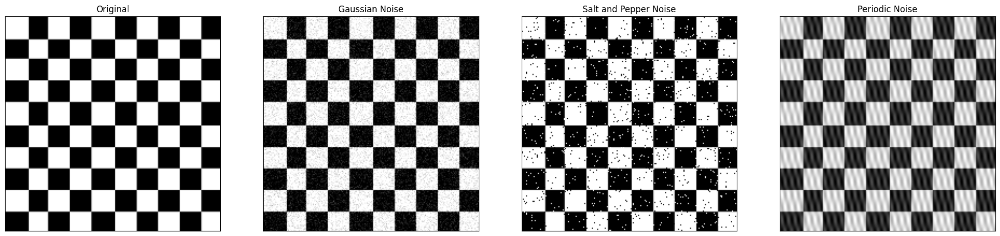

In [ ]:
period_ns_img = period_noise(img)

# Displaying results
display_subplots([img, gauss_ns_img, salt_ns_img, period_ns_img], (1,4),
              ['Original', 'Gaussian Noise', 'Salt and Pepper Noise', 'Periodic Noise'],
               None, [None]*4, (25,15), cmap='gray')

### (b) Denoising Image: Comparison of Denoising Filters

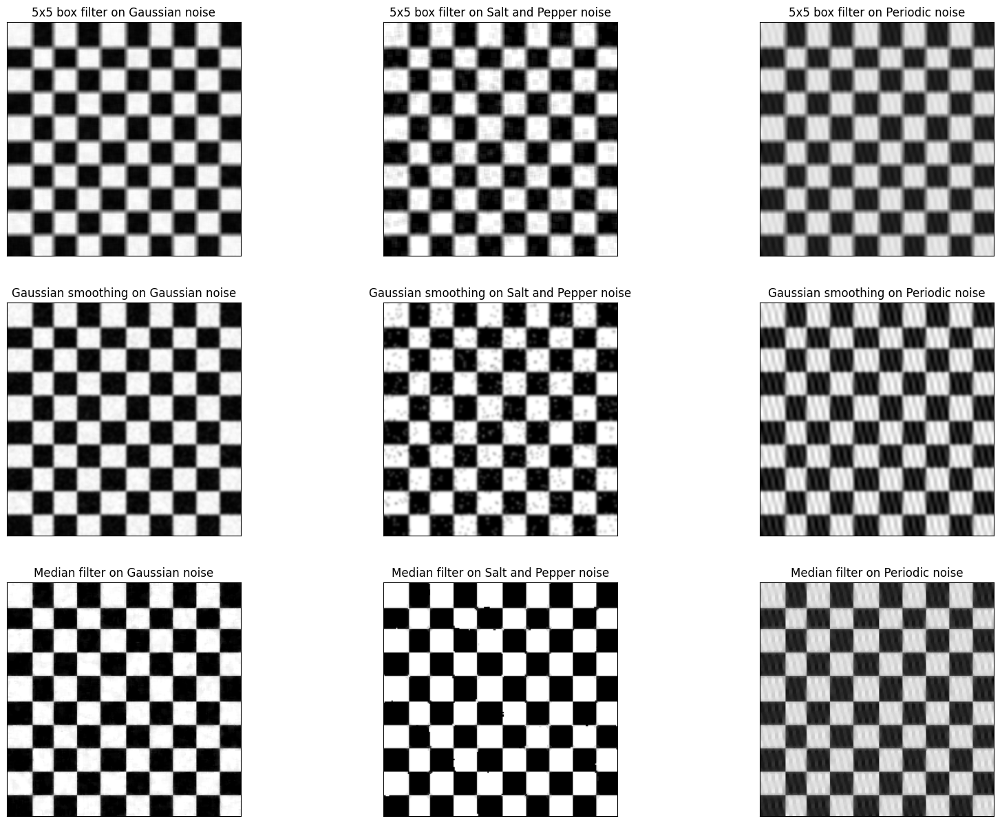

In [ ]:
# Box flter of size 5x5
box = np.ones((5, 5))/(5 * 5)

# Displaying results
display_subplots([cv2.filter2D(gauss_ns_img, -1, box), cv2.filter2D(salt_ns_img, -1, box), cv2.filter2D(period_ns_img, -1, box),
               cv2.GaussianBlur(gauss_ns_img, (5,5), 0), cv2.GaussianBlur(salt_ns_img, (5,5), 0), cv2.GaussianBlur(period_ns_img, (5,5), 0),
               cv2.medianBlur(gauss_ns_img, 5), cv2.medianBlur(salt_ns_img, 5), cv2.medianBlur(period_ns_img, 5)], (3,3),
               ['5x5 box filter on Gaussian noise', '5x5 box filter on Salt and Pepper noise', '5x5 box filter on Periodic noise',
               'Gaussian smoothing on Gaussian noise', 'Gaussian smoothing on Salt and Pepper noise','Gaussian smoothing on Periodic noise',
               'Median filter on Gaussian noise', 'Median filter on Salt and Pepper noise', 'Median filter on Periodic noise'],
               '', [None]*12, (20, 15), 'gray')

### Notch Filters on Periodic Noise

In [ ]:
def ideal_notch(img):
  '''
      Applying Ideal-Notch Filter
  '''
  img = np.asarray(img)

  # Compute the 2-dimensional discrete Fourier Transform of the input image
  f = np.fft.fft2(img)

  # Shift the zero-frequency component to the center of the spectrum
  fshift = np.fft.fftshift(f)

  # Compute the magnitude spectrum in the frequency domain and apply log transformation for visualization
  dft, d0 = 20 * np.log(np.abs(fshift)), 0.5
  M, N  = fshift.shape #dimensions of the shifted spectrum

  # Coordinates of the points where the notch filter should be applied
  points = get_fshift_and_save_dft(img.copy())

  # Loop through each frequency component in the shifted spectrum
  for u in range(M):
    for v in range(N):

      # Loop through each notch filter point
      for d in range(len(points)):
        u0, v0 = points[d][0], points[d][1]

        # Compute the distances from the current frequency component to the notch filter points
        d1 = pow(pow(u - u0, 2) + pow(v - v0, 2), 1)
        d2 = pow(pow(u + u0, 2) + pow(v + v0, 2), 1)

        # If the distance is within the specified threshold, zero out the frequency component
        if d1 <= d0 or d2 <= d0:
          fshift[u][v] *= 0.0

  # Shift the zero-frequency component back to the corner
  f_ishift = np.fft.ifftshift(fshift)

  # Compute the 2-dimensional inverse discrete Fourier Transform to get the filtered image
  return np.abs(np.fft.ifft2(f_ishift))


def gauss_notch(img):
  '''
      Applying the Gaussian-Notch Filter
  '''
  img = np.asarray(img)

  # Compute the 2-dimensional discrete Fourier Transform of the input image
  f = np.fft.fft2(img)

  # Shift the zero-frequency component to the center of the spectrum
  fshift = np.fft.fftshift(f)

  # Compute the magnitude spectrum in the frequency domain and apply log transformation for visualization
  dft, d0 = 20 * np.log(np.abs(fshift)), 0.5

  # Get the coordinates of the points where the notch filter should be applied
  points = get_fshift_and_save_dft(img.copy())

  M, N = fshift.shape #dimensions of shifted spectrum

  # Loop through each frequency component in the shifted spectrum
  for u in range(M):
    for v in range(N):

      # Loop through each notch filter point
      for d in range(len(points)):
        u0, v0 = points[d][0], points[d][1]

        # Compute the distances from the current frequency component to the notch filter points
        d1 = pow(pow(u - u0, 2) + pow(v - v0, 2), 0.5)
        d2 = pow(pow(u + u0, 2) + pow(v + v0, 2), 0.5)

        # Apply the Gaussian-Notch filter
        fshift[u][v] *= (1 - math.exp(-0.5 * (d1 * d2 / pow(d0, 2))))

  # Shift the zero-frequency component back to the corner
  f_ishift = np.fft.ifftshift(fshift)

  # Compute the 2-dimensional inverse discrete Fourier Transform to get the filtered image
  return np.abs(np.fft.ifft2(f_ishift))


def butter_notch(img):
  '''
      Applying Butterworth-Notch Filter
  '''
  img = np.asarray(img)

  # Compute the 2-dimensional discrete Fourier Transform of the input image
  f = np.fft.fft2(img)

  # Shift the zero-frequency component to the center of the spectrum
  fshift = np.fft.fftshift(f)

  # Compute the magnitude spectrum in the frequency domain and apply log transformation for visualization
  dft, d0, eps = 20 * np.log(np.abs(fshift)), 0.5, 0.000001

  # Get the coordinates of the points where the notch filter should be applied
  points = get_fshift_and_save_dft(img.copy())

  M, N = fshift.shape #dimensions of shifted spectrum

  # Loop through each frequency component in the shifted spectrum
  for u in range(M):
    for v in range(N):

      # Loop through each notch filter point
      for d in range(len(points)):
        u0, v0 = points[d][0], points[d][1]

        # Compute the distances from the current frequency component to the notch filter points
        d1 = pow(pow(u - u0, 2) + pow(v - v0, 2), 0.5)
        d2 = pow(pow(u + u0, 2) + pow(v + v0, 2), 0.5)

        # Apply the Butterworth-Notch filter
        fshift[u][v] *= (1.0 / (1 + pow((d0 * d0) / (d1 * d2 + eps), 1)))

  # Shift the zero-frequency component back to the corner
  f_ishift = np.fft.ifftshift(fshift)

  # Compute the 2-dimensional inverse discrete Fourier Transform to get the filtered image
  return np.abs(np.fft.ifft2(f_ishift))

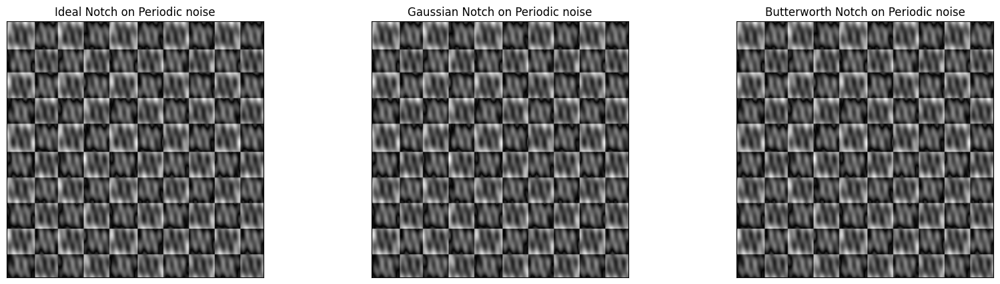

In [ ]:
display_subplots([ideal_notch(period_ns_img), gauss_notch(period_ns_img), butter_notch(period_ns_img)], (1,3),
               ['Ideal Notch on Periodic noise', 'Gaussian Notch on Periodic noise', 'Butterworth Notch on Periodic noise'],
               '', [None]*3, (20, 5), 'gray')

Observations:

1. The median filter emerges as the most effective solution for reducing Salt and Pepper noise compared to other filters.

2. Despite its effectiveness in reducing Gaussian noise, the median filter noticeably reduces the contrast of the image.

3. None of the techniques prove highly successful in eliminating periodic noise, with the median filter showing relatively better performance but still falling short of satisfactory results.

4. Notch filters, primarily employed for periodic noise removal, prove ineffective in addressing this type of noise and do not yield satisfactory outcomes.

### Comparison Of Notch Filter

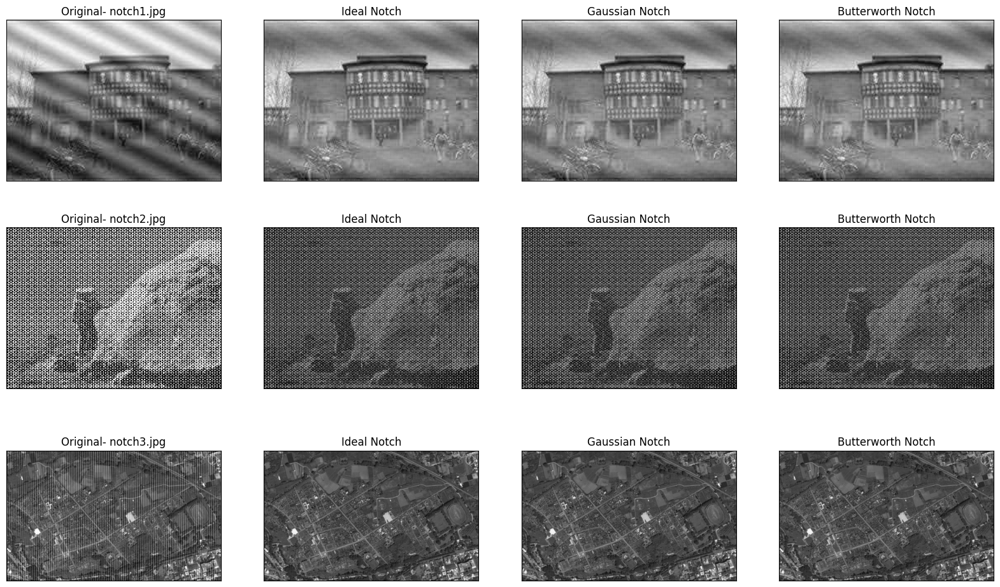

In [ ]:
# Reading notch images
im_list = [cv2.imread('images/notch1.jpg', 0), cv2.imread('images/notch2.png', 0), cv2.imread('images/notch3.jpg', 0)]

# Applying different filters
img_list, title_list = [], []

for i in range(3):
  img_list.append(im_list[i])
  title_list.append(f'Original- notch{i+1}.jpg')

  img_list.append(ideal_notch(im_list[i]))
  title_list.append('Ideal Notch')

  img_list.append(gauss_notch(im_list[i]))
  title_list.append('Gaussian Notch')

  img_list.append(butter_notch(im_list[i]))
  title_list.append('Butterworth Notch')

# Displaying results
display_subplots(img_list, (3,4), title_list, '', [None]*12, (20, 12), 'gray')

Based on the provided plots, it's evident that the three notch filters (Ideal, Gaussian, and Butterworth) exhibit similar performance across all three images. It's noteworthy that these filters do not satisfactorily remove the periodic noise in the first two images. However, for the third image ('notch3.jpg'), they notably excel in cleaning the noise.

# 2.
### Histograms for Images

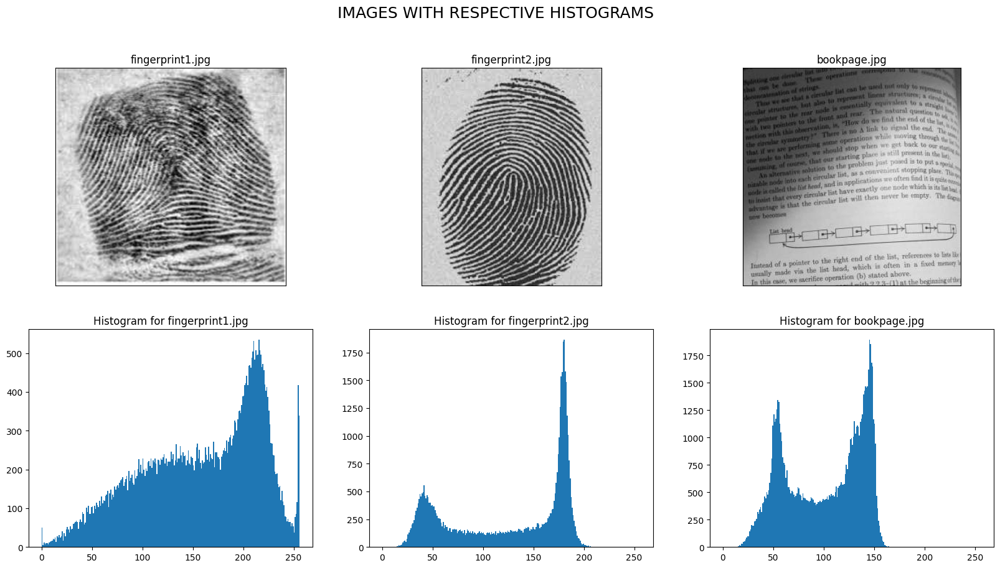

In [ ]:
# Reading images
fp_img1, fp_img2, bp_img = cv2.imread('images/fingerprint1.jpg', 0), cv2.imread('images/fingerprint2.jpg', 0), cv2.imread('images/bookpage.jpg', 0)

# Creating a list of the above images
im_list = [fp_img1, fp_img2, bp_img]
names = ["fingerprint1.jpg", "fingerprint2.jpg", "bookpage.jpg"]

# Plotting histograms for each of the above image
fig, ax = plt.subplots(2, 3, figsize = (20, 10))

for i in range(3):
  ax[0][i].imshow(im_list[i], cmap = 'gray')
  ax[0][i].set_title(names[i])

  ax[0][i].set_xticks([])
  ax[0][i].set_yticks([])

  ax[1][i].hist(im_list[i].ravel(), 256, [0,256])
  ax[1][i].set_title(f"\nHistogram for {names[i]}")

fig.suptitle('IMAGES WITH RESPECTIVE HISTOGRAMS', fontsize=18)
plt.show()

### Manual Thresholding

In [ ]:
def manual_thresh(img_list, threshold_value):
    thresholded_images = []

    for img in img_list:
        # Apply binary thresholding to the current image
        _, thresholded_img = cv2.threshold(img, threshold_value, 255, cv2.THRESH_BINARY)
        thresholded_images.append(thresholded_img)

    return thresholded_images

# Threshold the images with a threshold value of 128
img_thresh = manual_thresh([fp_img1, fp_img2, bp_img], 128)

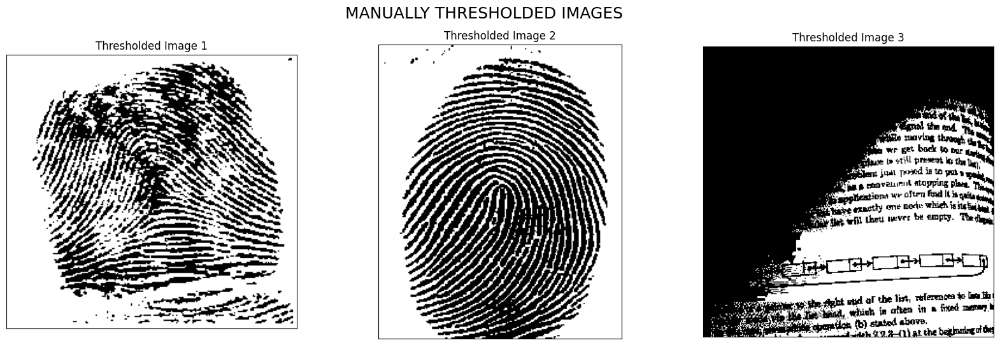

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(20, 6))

# Iterate over each thresholded image and its corresponding axis
for i, thresh_img in enumerate(img_thresh):
    ax[i].imshow(thresh_img, cmap='gray')
    ax[i].set_title(f"Thresholded Image {i+1}")
    ax[i].set_xticks([])
    ax[i].set_yticks([])

fig.suptitle('MANUALLY THRESHOLDED IMAGES', fontsize=18)
plt.show()

### Global Thresholding

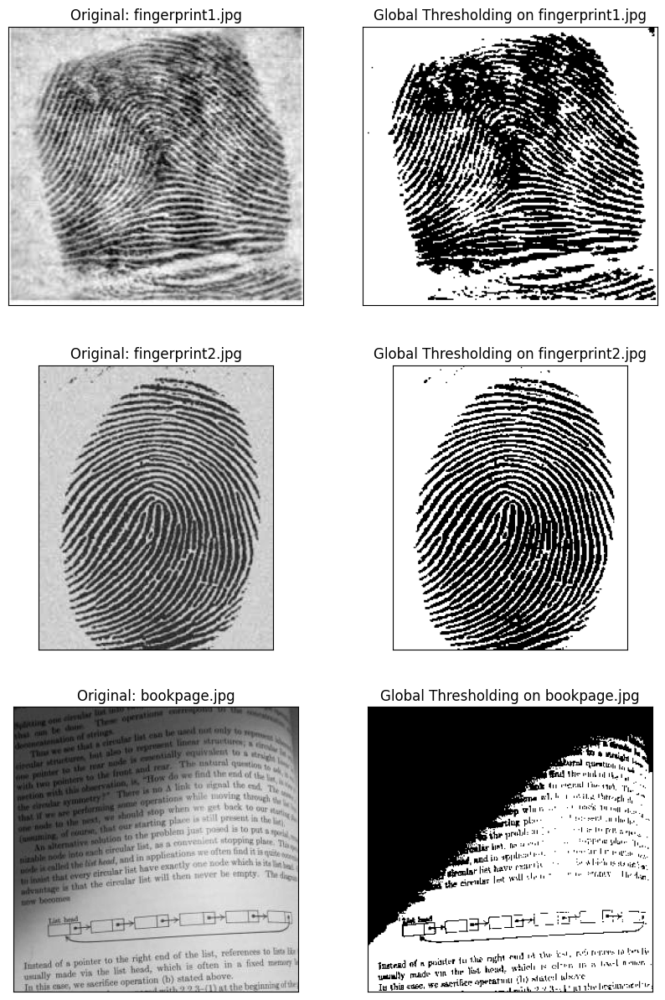

In [ ]:
# List of threshold values
t = [150,120,100]

# Lists to store images, titles, threshold return values, and thresholded images
imgs, titles, ret1, th1 = [], [], [], []

# Loop through each threshold value
for i in range(3):
  imgs.append(im_list[i])
  titles.append(f'Original: {names[i]}')

  # Apply global thresholding using cv2.threshold
  ret1.append(cv2.threshold(im_list[i], t[i], 255, cv2.THRESH_BINARY)[0])
  th1.append(cv2.threshold(im_list[i], t[i], 255, cv2.THRESH_BINARY)[1])

  # Append the thresholded image and its title
  imgs.append(th1[i])
  titles.append(f'Global Thresholding on {names[i]}')

# Displaying results
display_subplots(imgs, (3,2), titles, '', [None]*6, (10,15), 'gray')

### Otsu's Method

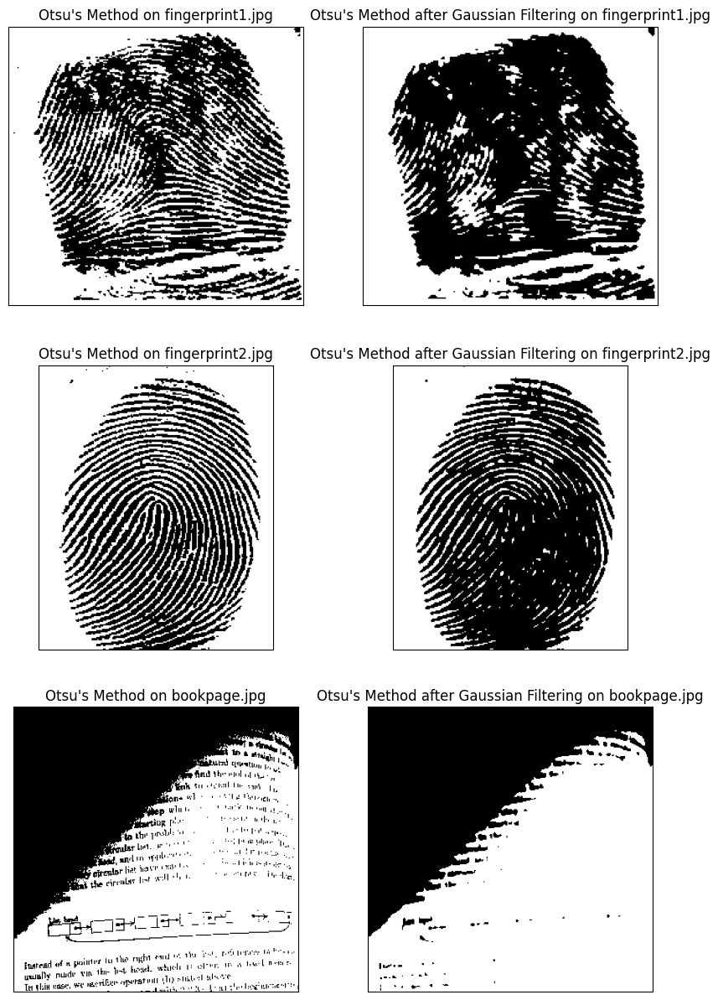

In [ ]:
imgs, titles = [], []

for i in range(3):
  # Apply Otsu's method for thresholding to the original image
  imgs.append(cv2.threshold(im_list[i], 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1])
  titles.append(f"Otsu's Method on {names[i]}")

  # Apply Gaussian filtering to the original image
  blur = cv2.GaussianBlur(im_list[i], (5,5), 0)

  # Apply Otsu's method for thresholding to the filtered image
  imgs.append(cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1])
  titles.append(f"Otsu's Method after Gaussian Filtering on {names[i]}")

# Displaying results
display_subplots(imgs, (3,2), titles,'', [None]*6, (10,15), 'gray')

From the above result we obsere that applying Otsu's method on original image is working better than applying the same on the Gaussian filtered image.

### Adaptive Thresholding

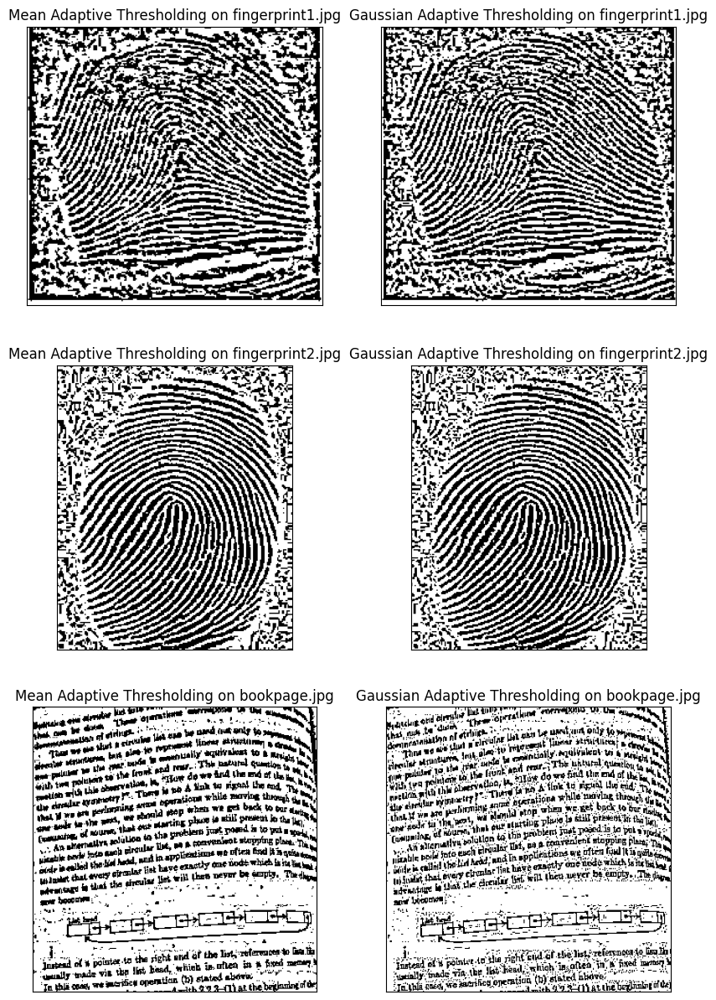

In [ ]:
imgs, titles = [], []

for i in range(3):
  # Mean adaptive thresholding
  imgs.append(cv2.adaptiveThreshold(im_list[i], 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2))
  titles.append(f"Mean Adaptive Thresholding on {names[i]}")

  # Gaussian adaptive thresholding
  imgs.append(cv2.adaptiveThreshold(im_list[i], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2))
  titles.append(f"Gaussian Adaptive Thresholding on {names[i]}")

# Displaying results
display_subplots(imgs, (3,2), titles, '', [None]*6, (10,15), 'gray')

From the above results we conclude that for the images fingerprint1.jpg and fingerprint2.jpg, global thresholding method and Otsu's method have worked better than adaptive thresholding methods, with Otsu's method providing slightly better results than global thresholding. This may be due to the fact that in case of global thresholding, we had set a threshold value manually ourselves, whereas on the contrary, in Otsu's method we measure the effectiveness of thresholding using the ratio of variances.

On the other hand, for the image bookpage.jpg, the adaptive thresolding methods (both mean and Gaussian) is working better than the rest of the methods we applied. Visually judging, we can conclude that mean-adaptive thresholding is working slighly better than the Gaussian alternative by removing more noise.

## 3.

In [ ]:
# Applying Sobel filter
def app_sob(img):
  # Define Sobel kernels for x and y directions
  sobel_x = cv2.flip(np.array([[-1,0,1],[-2,0,2],[-1,0,1]]), -1)
  sobel_y = cv2.flip(np.array([[-1,-2,-1],[0,0,0],[1,2,1]]), -1)

  # Apply Sobel kernels to the image to detect edges in x and y directions
  sob_x = cv2.filter2D(img, -1, sobel_x)
  sob_y = cv2.filter2D(img, -1, sobel_y)

  # Combine the results from both directions to get the final edge-detected image
  return (0.5* sob_x) + (0.5*sob_y)


# Thresholding image
def app_threshold(img, threshold = 25):

  M,N = img.shape #image shape
  output = np.zeros((M,N)) #output image matrix

  # Iterate over each pixel in the image
  for i in range(M):
    for j in range(N):
      if img[i,j]>threshold:
        output[i,j] = 255 #white

  return output


# Applying LoG filtering
def app_log(img):
  # Apply Gaussian blur to the image
  img_den = cv2.GaussianBlur(img, (3, 3), 1.5)

  # Apply Laplacian of Gaussian (LoG) filter to the blurred image
  return cv2.Laplacian(img_den, cv2.CV_64F)


# Applying zero-crossing
def zero_crossing(image):
  z_c_image = np.zeros(image.shape) #zero-crossing image matrix

  # Now for each pixel, we count the number of positive and negative pixels in the neighborhood
  for i in range(1, image.shape[0] - 1):
    for j in range(1, image.shape[1] - 1):

      # Initialize counters for negative and positive values in the neighborhood
      neg, pos = 0, 0

      # Define the neighborhood of the current pixel
      neighbour = [image[i+1, j-1],image[i+1, j],image[i+1, j+1],image[i, j-1],image[i, j+1],image[i-1, j-1],image[i-1, j],image[i-1, j+1]]

      # Find the maximum and minimum pixel values in the neighborhood
      d, e = max(neighbour), min(neighbour)

      # Count the number of positive and negative values in the neighborhood
      for h in neighbour:
        if h>0: pos += 1
        elif h<0: neg += 1

      # If both negative and positive values exist in the pixel neighborhood, then that pixel is a potential zero crossing
      z_c = ((neg > 0) and (pos > 0))

      # Change the pixel value with the maximum neighborhood difference with the pixel
      if z_c:
        if image[i,j]>0:
          # Enhance the pixel value by adding the absolute value of the minimum neighborhood difference
          z_c_image[i, j] = image[i,j] + np.abs(e)

        elif image[i,j]<0:
          # Enhance the pixel value by adding the maximum neighborhood difference
          z_c_image[i, j] = np.abs(image[i,j]) + d

  # Normalize and change datatype to 'uint8' (optional)
  z_c_norm = z_c_image/z_c_image.max()*255
  z_c_image = np.uint8(z_c_norm)

  return z_c_image

### (a) Sobel Kernel

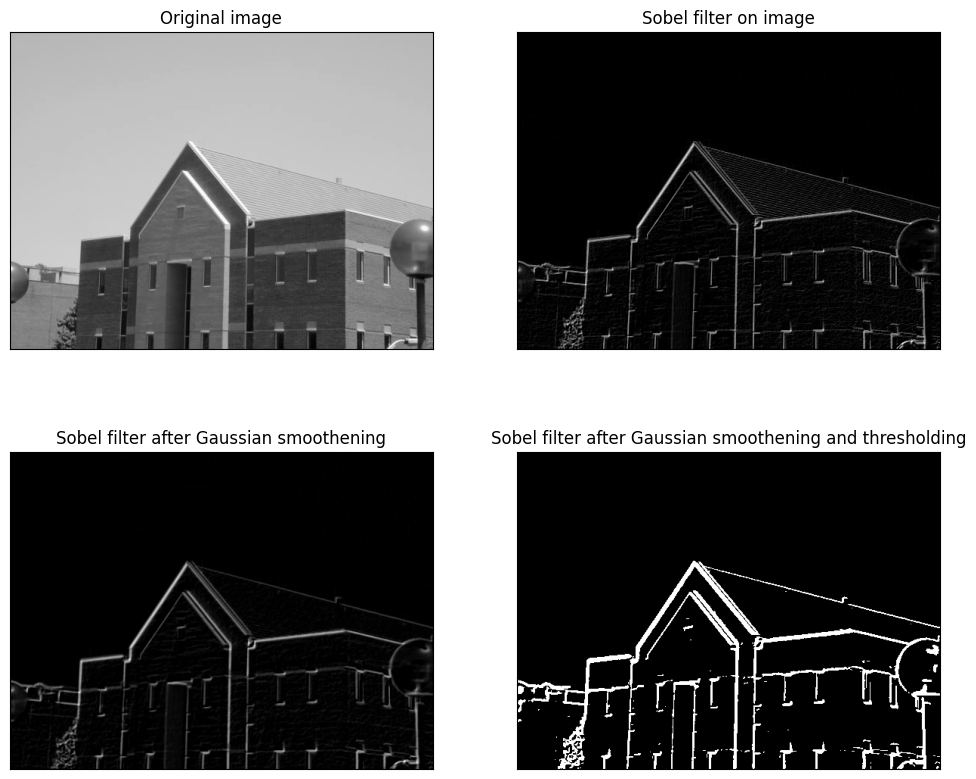

In [ ]:
# Reading building.jpg
img = cv2.imread('images/building.jpg', 0)

# Gaussian Smooothening
img_noise_rem = cv2.GaussianBlur(img, (3, 3), 1.5)

# Applying sobel filter
sob_img = app_sob(img)
sob_img_noise_rem = app_sob(img_noise_rem)
sob_img_threshold = app_threshold(sob_img_noise_rem)

# Displaying results
display_subplots([img, sob_img, sob_img_noise_rem, sob_img_threshold], (2,2),
              ['Original image', 'Sobel filter on image',
               'Sobel filter after Gaussian smoothening',
               'Sobel filter after Gaussian smoothening and thresholding'],
               None, [None]*4, (12,10), cmap='gray')

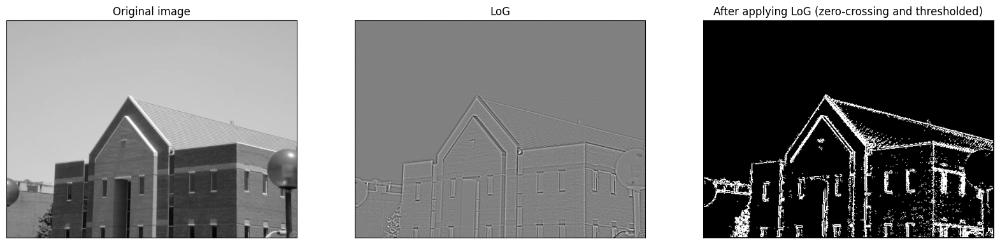

In [ ]:
# Applying LoG
log_img = app_log(img)

# Applying zero-crossing
zc_log = zero_crossing(log_img)

# Applying thresholding
zc_log = app_threshold(zc_log, threshold = 35)

# Displaying results
display_subplots([img, log_img, zc_log], (1,3),
              ['Original image', 'LoG', 'After applying LoG (zero-crossing and thresholded)'],
               None, [None]*3, (20,12), cmap='gray')

### (c) Canny Edge Detection

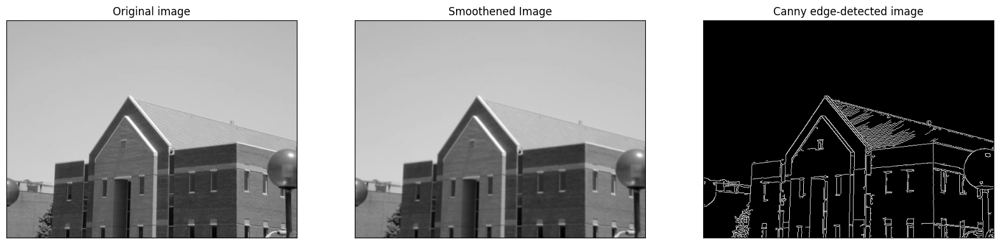

In [ ]:
# Canny edge detection
smooth = cv2.GaussianBlur(img, (3,3), 1.5)
canny = cv2.Canny(img, 40, 150)

# Displaying results
display_subplots([img, smooth, canny], (1,3),
              ['Original image', 'Smoothened Image', 'Canny edge-detected image'],
               None, [None]*3, (20,12), cmap='gray')

### (d) Hough transform

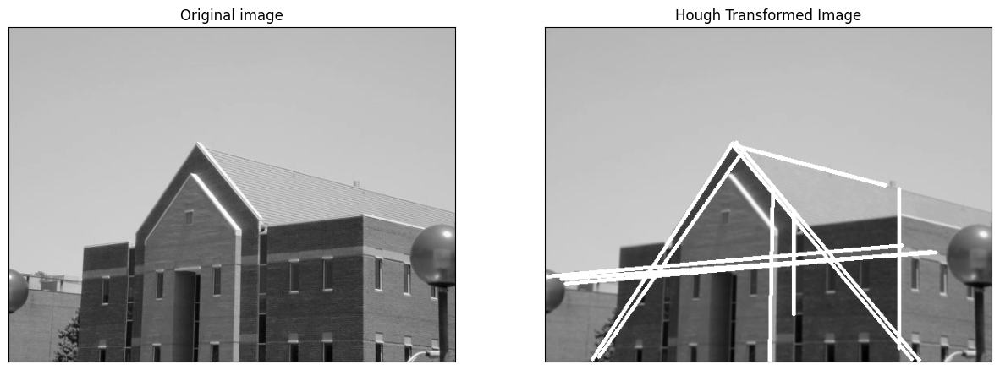

In [ ]:
# Hough Transform
hough_image = cv2.GaussianBlur(img, (3,3), 1.5)

edges = cv2.Canny(hough_image, 50, 200, apertureSize = 3)
lines = cv2.HoughLinesP(edges, 2, np.pi/180, threshold = 150, minLineLength=100, maxLineGap=250)

# Draw lines on the image
for line in lines:
    x1, y1, x2, y2 = line[0]
    cv2.line(hough_image, (x1, y1), (x2, y2), (255, 0, 0), 3)

# Displaying results
display_subplots([img, hough_image], (1,2),
              ['Original image', 'Hough Transformed Image'],
               None, [None]*2, (15,8), cmap='gray')

### Comparison of Edge Detection techniques on the 2 images

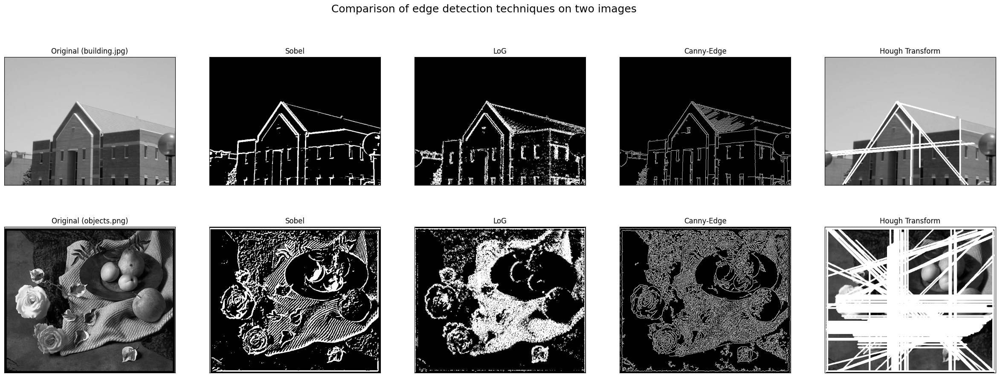

In [ ]:
# Reading building.jpg
img2 = cv2.imread('images/objects.png', 0)

# Gaussian Smooothening
img_noise_rem2 = cv2.GaussianBlur(img2, (3, 3), 1.5)

# Applying sobel filter
sob_img2 = app_sob(img2)
sob_img_noise_rem2 = app_sob(img_noise_rem2)
sob_img_threshold2 = app_threshold(sob_img_noise_rem2)

# Applying LoG
log_img2 = app_log(img2)

# Applying zero-crossing
zc_log2 = zero_crossing(log_img2)

# Applying thresholding
zc_log2 = app_threshold(zc_log2, threshold = 35)

# Canny edge detection
smooth2 = cv2.GaussianBlur(img2, (3,3), 1.5)
canny2 = cv2.Canny(img2, 40, 150)

# Hough Transform
hough_image2 = cv2.GaussianBlur(img2, (3,3), 1.5)
edges2 = cv2.Canny(hough_image2, 50, 200, apertureSize = 3)
lines2 = cv2.HoughLinesP(edges2, 2, np.pi/180, threshold = 150, minLineLength=100,
                        maxLineGap=250)

# Draw lines on the image
for line in lines2:
    x1, y1, x2, y2 = line[0]
    cv2.line(hough_image2, (x1, y1), (x2, y2), (255, 0, 0), 3)

# Displaying results
display_subplots([img, sob_img_threshold, zc_log, canny, hough_image,
               img2, sob_img_threshold2, zc_log2, canny2, hough_image2], (2,5),
              ['Original (building.jpg)', 'Sobel', 'LoG', 'Canny-Edge', 'Hough Transform',
               'Original (objects.png)', 'Sobel', 'LoG', 'Canny-Edge', 'Hough Transform'],
               'Comparison of edge detection techniques on two images', [None]*10, (30,10), cmap='gray')

By visual comparison we immediately conclude that Canny Edge Detection works the best for building.jpg. From the above results we also observe that for building.jpg, Hough transform has been able to detect the lines since the image has very well-defined straight lines.

On the other hand, for the image objects.png, Hough transform fails terribly in edge-detection since the image contains mostly circular and curved objects with non-linear edges. For such an image we may implement the method described below (Hough transform for circular edge detection):

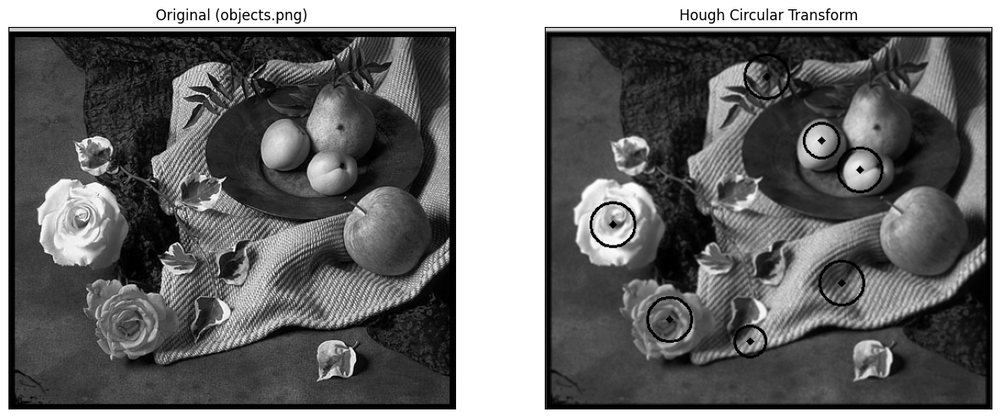

In [ ]:
# Hough transform to detect circular edges
circles = cv2.HoughCircles(img_noise_rem2, cv2.HOUGH_GRADIENT, 1, 20, param1=50, param2=30, minRadius=10, maxRadius=25)
circles = np.uint16(np.around(circles))

for i in circles[0,:]:
  # Draw the outer circle
  cv2.circle(img_noise_rem2, (i[0],i[1]), i[2], (0,255,0), 2)

  # Draw the center of the circle
  cv2.circle(img_noise_rem2, (i[0],i[1]), 2, (0,0,255), 3)

# Displaying results
display_subplots([img2, img_noise_rem2], (1,2),
              ['Original (objects.png)', 'Hough Circular Transform'],
               None, [None]*2, (15,8), cmap='gray')

## 4.

In [ ]:
# K-mean segmentation
def k_means(img, img_name):
  Z = np.float32(img.reshape((-1,3)))

  # defining criterion, number of clusters(K) and apply kmeans()
  criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
  Ks, seg_img = [2, 3, 4, 5, 7, 8, 10, 11, 12, 15, 20, 25, 30, 40, 50], {}
  images, titles = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB)], [img_name]

  for k in Ks:
    ret, label, center = cv2.kmeans(Z, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    # Converting back into uint8 to make original image
    center = np.uint8(center)
    seg_img[k] = center[label.flatten()].reshape((img.shape))
    images.append(cv2.cvtColor(seg_img[k], cv2.COLOR_BGR2RGB))
    titles.append(f'K = {k}')

  # Displaying results
  display_subplots(images, (4,4), titles, f'K-means segmentation on {img_name}', [None]*16,
                (20, 15))


# Superpixel algorithm on various segments
def sup_pix(img, img_name, pix):

  # Converting image to floating data-type
  img = img_as_float(img)
  images, titles = [], []

  # looping over no. of segments
  for seg in pix:

    # apply SLIC and extract (approximately) the supplied number of segments
    segments = slic(img, n_segments = seg, sigma = 5, start_label = 1)
    images.append(mark_boundaries(img, segments))
    titles.append(f'No. of superpixels: {seg}')

  # Displaying results
  display_subplots(images, (3,3), titles,
                  f'Comparison of superpixel on {img_name} with different superpixel segments',
                  [None]*9, (18, 12))


# Apply GrabCut algorithm for segmentation
def grabcut_segmentation(img):
  mask = np.zeros(img.shape[:2],np.uint8)

  # Initialize the background and foreground models
  bgdModel = np.zeros((1,65),np.float64)
  fgdModel = np.zeros((1,65),np.float64)

  # Define the rectangle for initial segmentation
  rect = (50,50,img.shape[1]-50,img.shape[0]-50)

  # Apply GrabCut algorithm
  cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)

  # Modify the mask to mark the definite background and probable foreground areas
  mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')

  # Apply the modified mask to the original image
  segmented_img = img * mask2[:,:,np.newaxis]

  # Display the original and segmented images
  plt.figure(figsize=(20, 5))
  plt.subplot(121), plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
  plt.subplot(122), plt.imshow(cv2.cvtColor(segmented_img, cv2.COLOR_BGR2RGB)), plt.title('Segmented Image - GrabCut')
  plt.show()


# Apply watershed algorithm for segmentation
def water_shed(img_path, img_name, resize = False):
  # Read image
  img = img_as_ubyte(cv2.imread(img_path, 0))
  # if resize:
  #   img = cv2.resize(img, (1500, 750))

  # Denoise image
  den = rank.median(img, disk(2))

  # Find continuous region (low gradient - where less than 10 for this image) --> markers
  # disk(5) is used here to get a more smooth image
  markers = rank.gradient(den, disk(5)) < 10
  markers = ndi.label(markers)[0]

  # local gradient (disk(2) is used to keep edges thin)
  grad = rank.gradient(den, disk(2))

  # process the watershed
  labels = watershed(grad, markers)

  # Displaying results
  fig, ax = plt.subplots(nrows= 1, ncols= 2, figsize= (15, 15), sharex= True, sharey= True)

  ax[0].imshow(io.imread(img_path), cmap= plt.cm.gray)
  ax[0].set_title(f"Original: {img_name}")

  ax[1].imshow(img, cmap= plt.cm.gray)
  ax[1].imshow(labels, cmap= plt.cm.nipy_spectral, alpha= 0.5)
  ax[1].set_title("Segmented")

  for i in ax:
    i.axis('off')

  fig.tight_layout()
  plt.show()

In [ ]:
img_path = 'images/pizza/pizza1.jpg'
img_name = 'Pizza1.jpg'

img = cv2.imread(img_path)

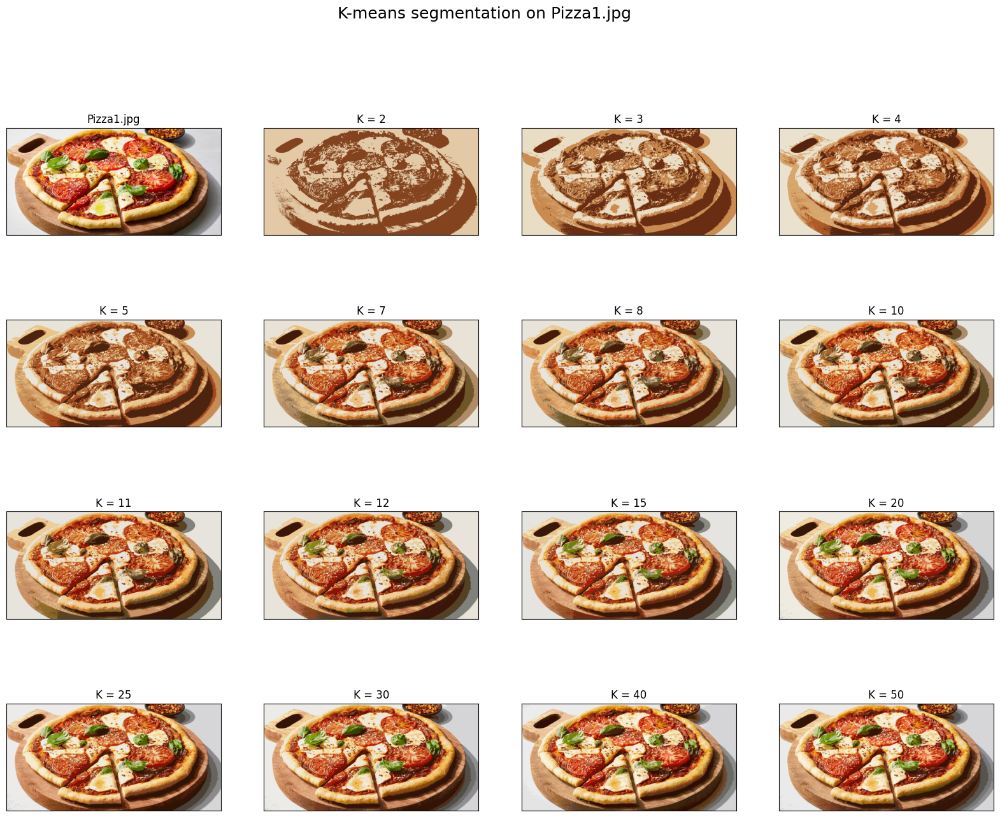

In [ ]:
# Apply the K-means clustering algorithm to segment the image
k_means(img, img_name)

From the above results, we observed that the segmentation improves with the increase in binning-size since the K-means algorithm can classify more classes (here, cluster of similar colors).

We also observe that the resulting image gets closer to the original image as we increase the number of bins. This is expected since increasing the bin-size leads to the pixel values of the original image getting classified into larger number of clusters resulting in almost similar distribution of the original image.

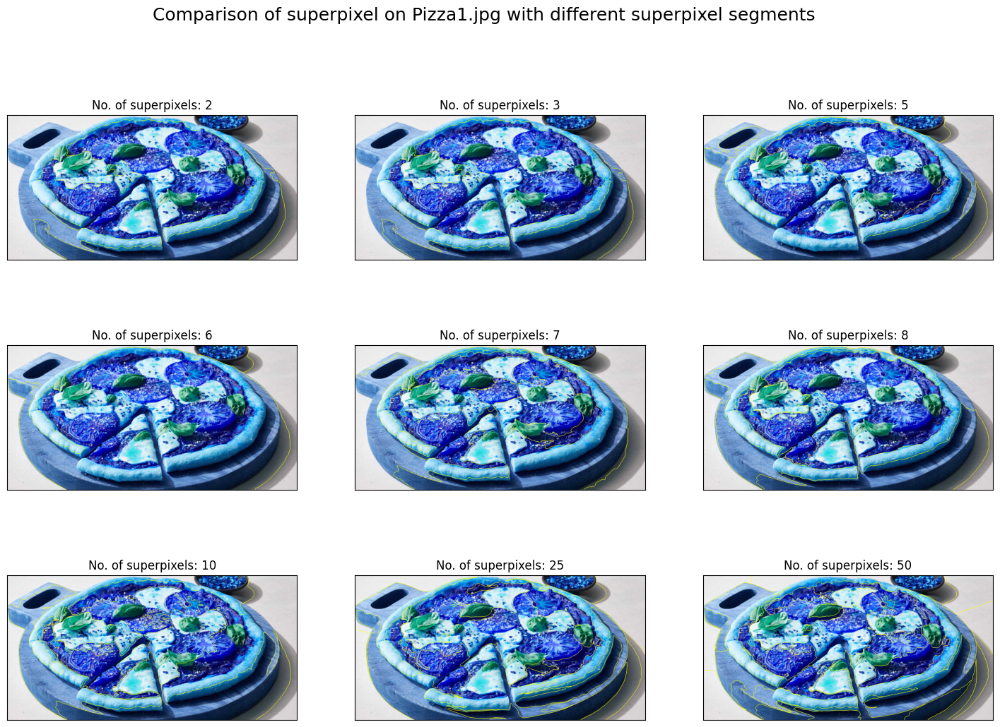

In [ ]:
# Apply the Superpixels algorithm to segment the image
sup_pix(img, img_name, [2, 3, 5, 6, 7, 8, 10, 25, 50])

From the above results we observe that as the number of superpixels increase, the image gets more segmented according to the pixel values, as expected. When the number of segments is 6, the image gets more or less correctly segmented marking boundaries around the different color regions of the pizza (seperated by various shades). On increasing the number of superpixels the image starts to get over-segmented, thus gradually making the result less meaningful which is clearly observable for cases 25 and 50, where interpretation of segmentation is lost.

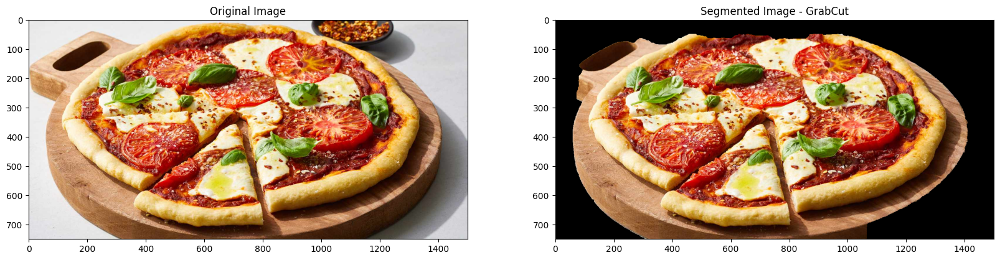

In [ ]:
# Apply the GrabCuts algorithm to segment the image
grabcut_segmentation(img)

The GrabCut method appears to provide a reasonable segmentation of the main elements and regions in the pizza image, while some finer details and precise boundaries may not be perfectly captured. The performance could potentially be improved further through parameter tuning or additional post-processing steps.

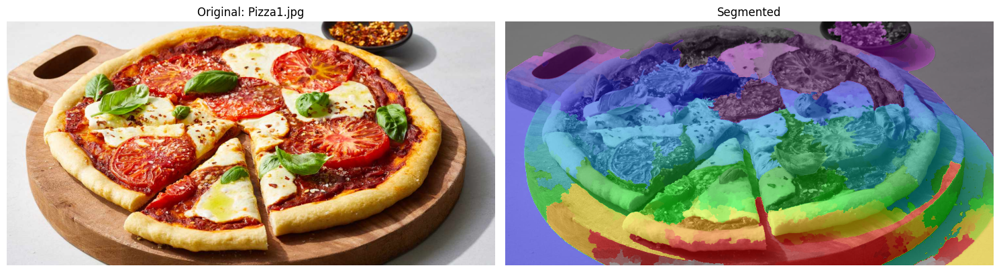

In [ ]:
# Apply the Watersheds algorithm to segment the image
water_shed(img_path, img_name)

The Watershed method seems to provide a reasonably good segmentation of the main components of the pizza image, with distinct separation of regions and well-defined boundaries. However, it may over-segment certain areas and lose some finer details, which could potentially be improved through parameter tuning or post-processing steps.

In [ ]:
img_path = 'images/pizza/pizza2.jpg'
img_name = 'Pizza2.jpg'

img = cv2.imread(img_path)
resized_image = cv2.resize(img, (1500, 750))

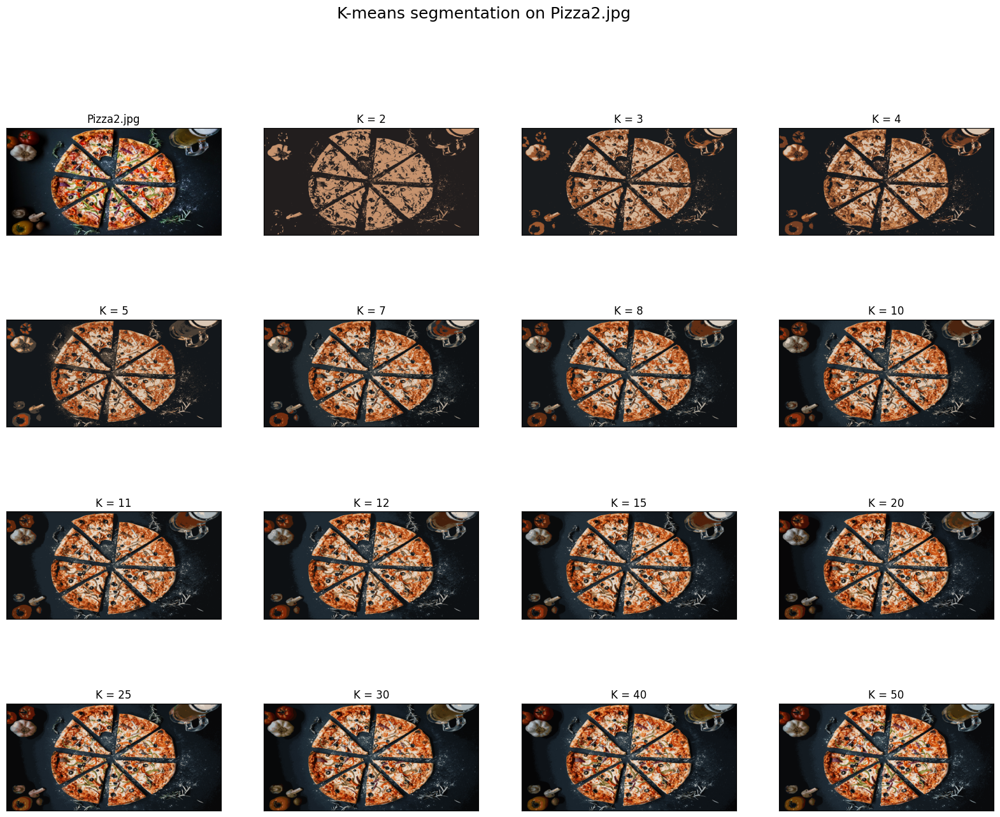

In [ ]:
# Apply the K-means clustering algorithm to segment the image
k_means(resized_image, img_name)

From the above results, we observed that the segmentation improves with the increase in binning-size since the K-means algorithm can classify more classes (here, cluster of similar colors).

We also observe that the resulting image gets closer to the original image as we increase the number of bins. This is expected since increasing the bin-size leads to the pixel values of the original image getting classified into larger number of clusters resulting in almost similar distribution of the original image.

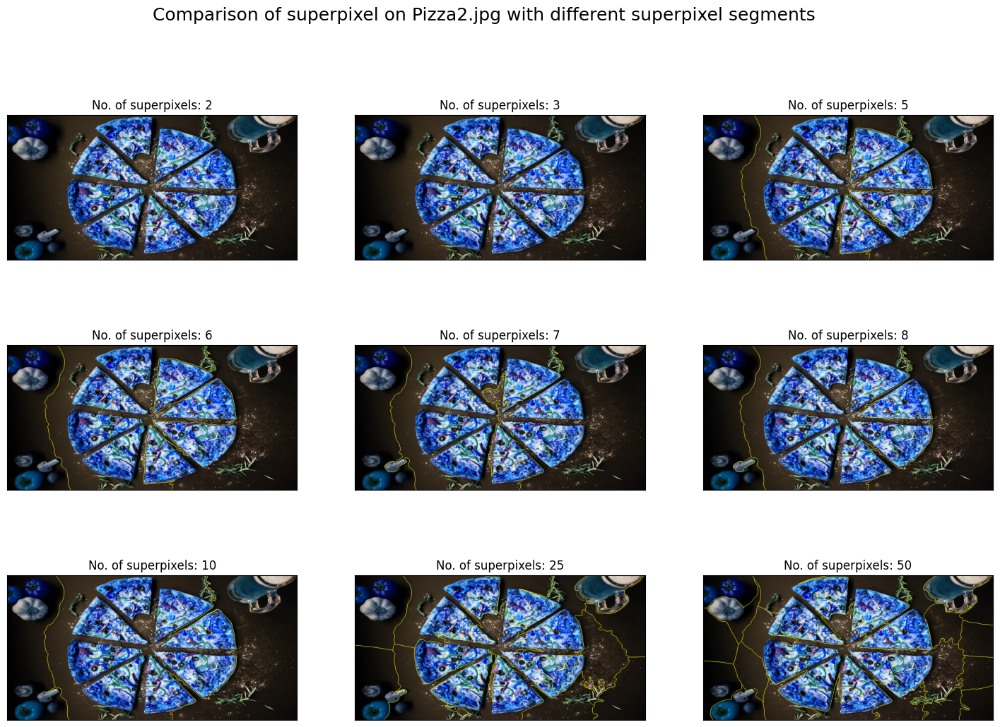

In [ ]:
# Apply the Superpixels algorithm to segment the image
sup_pix(resized_image, img_name, [2, 3, 5, 6, 7, 8, 10, 25, 50])

From the above results we observe that as the number of superpixels increase, the image gets more segmented according to the pixel values, as expected. When the number of segments is 6, the image gets more or less correctly segmented marking boundaries around the different color regions of the pizza (seperated by various shades). On increasing the number of superpixels the image starts to get over-segmented, thus gradually making the result less meaningful which is clearly observable for cases 25 and 50, where interpretation of segmentation is lost.

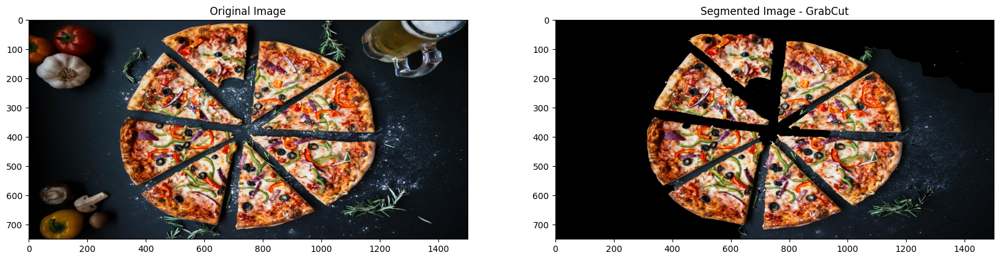

In [ ]:
# Apply the GrabCuts algorithm to segment the image
grabcut_segmentation(resized_image)

GrabCut seems to have done a decent job capturing the general shape and segments of the pizza slices and toppings. However, some finer details and boundaries may not be precisely delineated. The background items appear more roughly segmented as well.

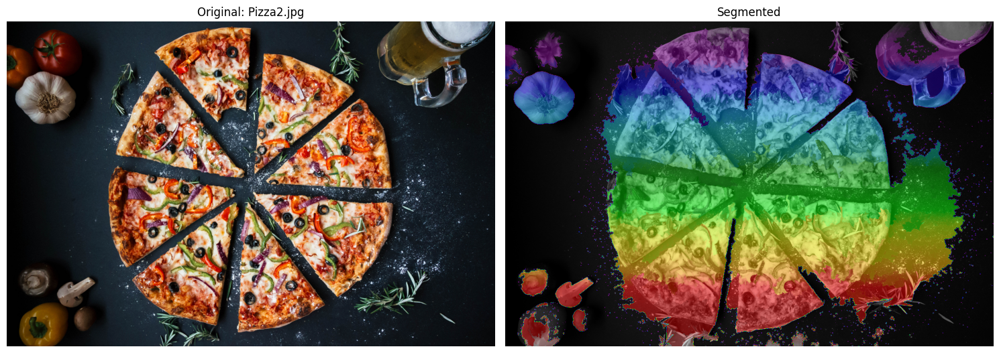

In [ ]:
# Apply the Watersheds algorithm to segment the image
water_shed(img_path, img_name, resize = True)

Compared to the previous GrabCut segmentation, this method seems to have done a better job at capturing finer details and separating the toppings on the pizza slices into distinct regions. However, there are still some areas where the boundaries between regions may not be perfectly delineated.

In [ ]:
img_path = 'images/furniture/chair1.jpg'
img_name = 'Chair1.jpg'

img = cv2.imread(img_path)

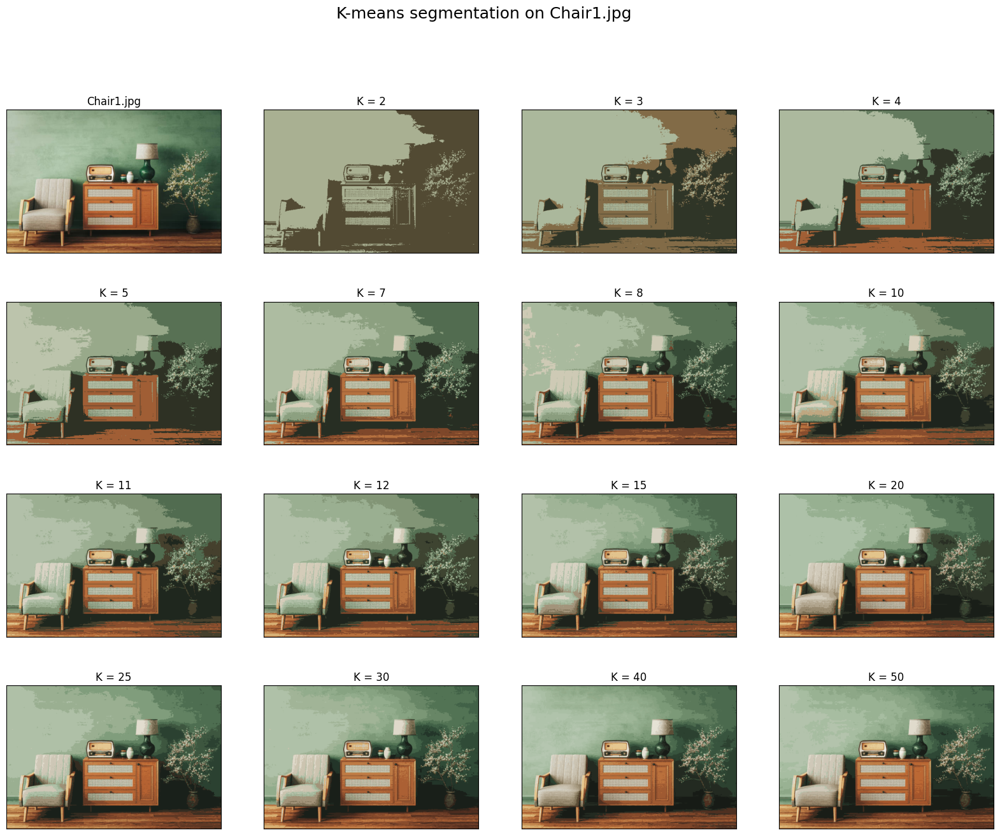

In [ ]:
# Apply the K-means clustering algorithm to segment the image
k_means(img, img_name)

From the above results, we observed that the segmentation improves with the increase in binning-size since the K-means algorithm can classify more classes (here, cluster of similar colors).

We also observe that the resulting image gets closer to the original image as we increase the number of bins. This is expected since increasing the bin-size leads to the pixel values of the original image getting classified into larger number of clusters resulting in almost similar distribution of the original image.

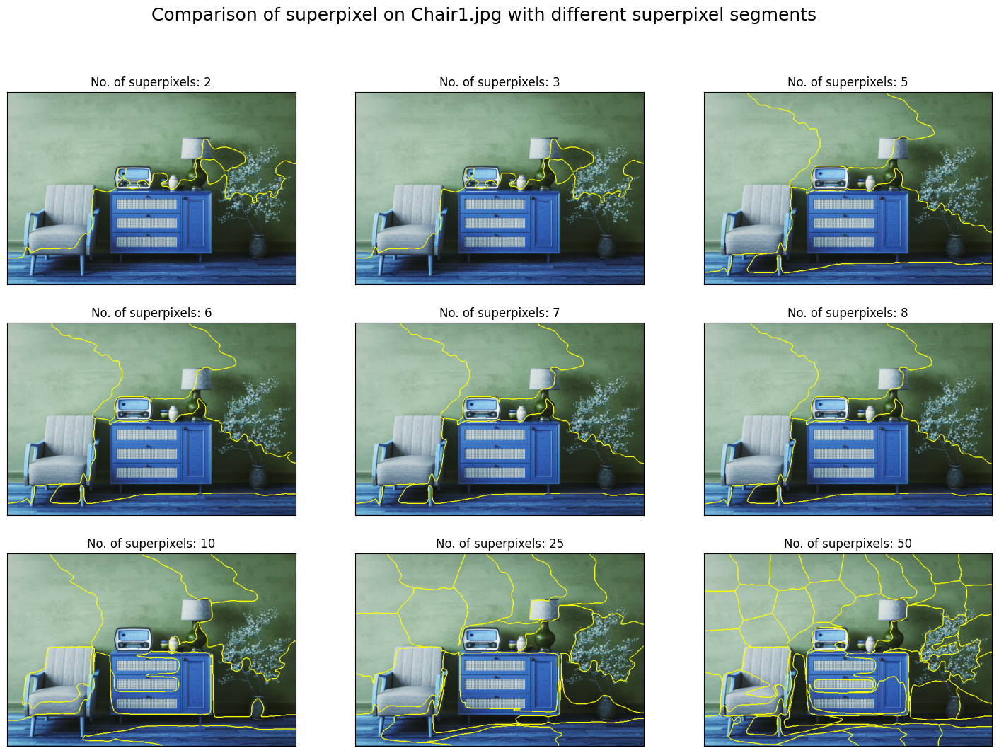

In [ ]:
# Apply the Superpixels algorithm to segment the image
sup_pix(img, img_name, [2, 3, 5, 6, 7, 8, 10, 25, 50])

From the above results we observe that as the number of superpixels increase, the image gets more segmented according to the pixel values, as expected. When the number of segments is 10, the image gets more or less correctly segmented marking boundaries around the different color regions of the furnitures in the picture (seperated by various shades). On increasing the number of superpixels the image starts to get over-segmented, thus gradually making the result less meaningful which is clearly observable for cases 25 and 50, where interpretation of segmentation is lost.

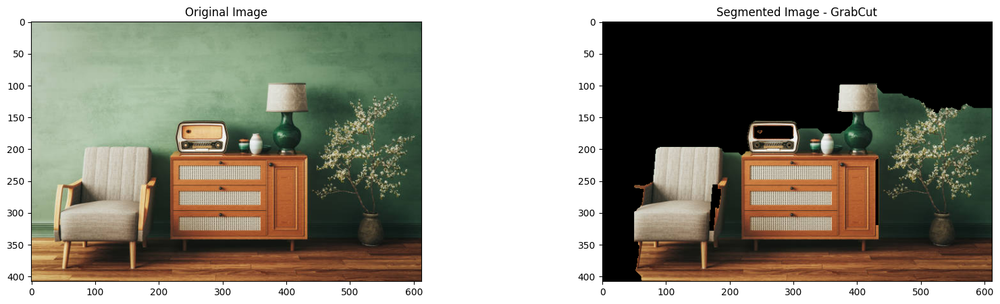

In [ ]:
# Apply the GrabCuts algorithm to segment the image
grabcut_segmentation(img)

The GrabCut algorithm seems to have done a decent job at capturing the overall shapes and boundaries of the major objects like the chair, cabinet, and floor. However, some finer details and textures appear to be smoothed out or lost in the segmentation process.

Additionally, the segmentation has struggled with separating the various decorative objects on top of the cabinet, likely due to their small size and similarity in color/texture to the cabinet itself.

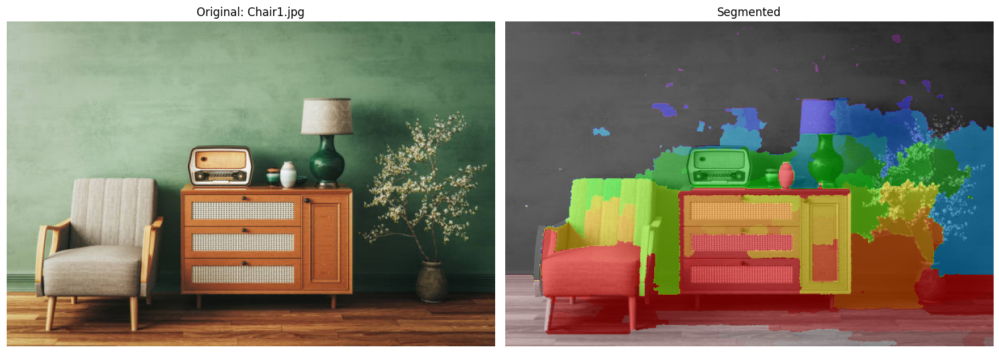

In [ ]:
# Apply the Watersheds algorithm to segment the image
water_shed(img_path, img_name)

The segmentation is fairly accurate. The pixels that belong to the chair and the cabinet have been correctly grouped together. There is some minor segmentation error around the edges of the objects. For example, a few pixels that belong to the chair have been grouped together with the pixels that belong to the cabinet.

In [ ]:
img_path = 'images/furniture/chair2.jpg'
img_name = 'Chair2.jpg'

img = cv2.imread(img_path)

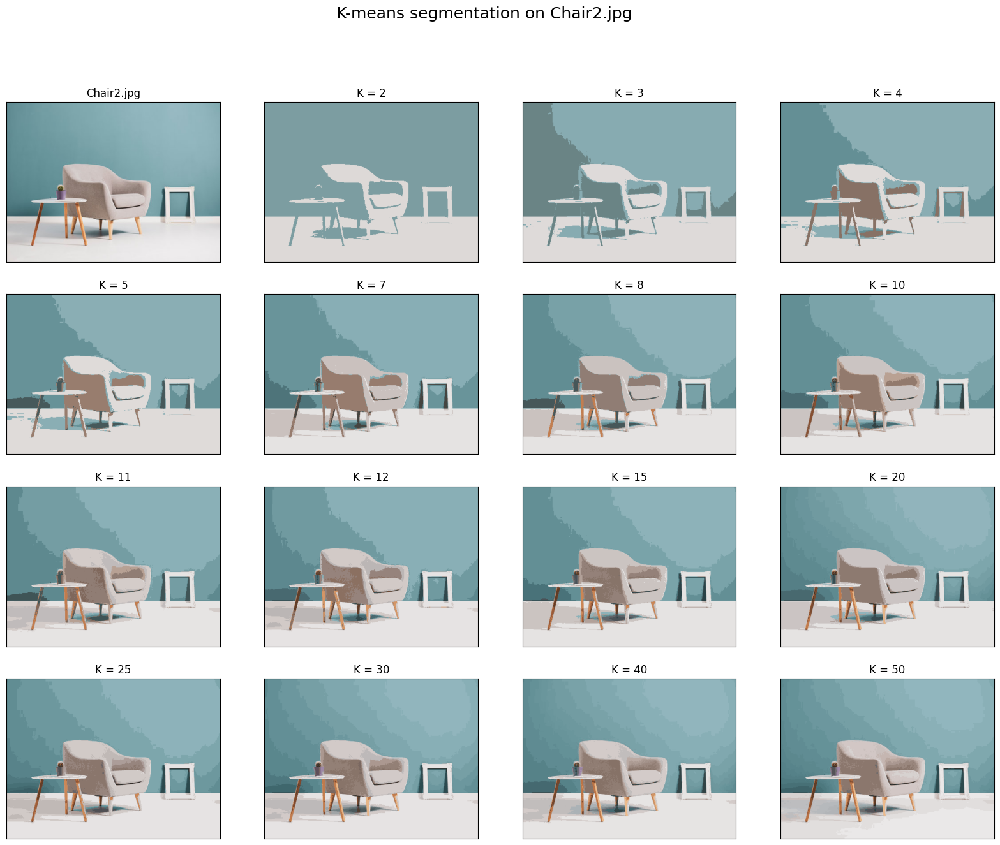

In [ ]:
img = cv2.imread('images/furniture/chair2.jpg')

# Apply the K-means clustering algorithm to segment the image
k_means(img, img_name)

From the above results, we observed that the segmentation improves with the increase in binning-size since the K-means algorithm can classify more classes (here, cluster of similar colors).

We also observe that the resulting image gets closer to the original image as we increase the number of bins. This is expected since increasing the bin-size leads to the pixel values of the original image getting classified into larger number of clusters resulting in almost similar distribution of the original image.

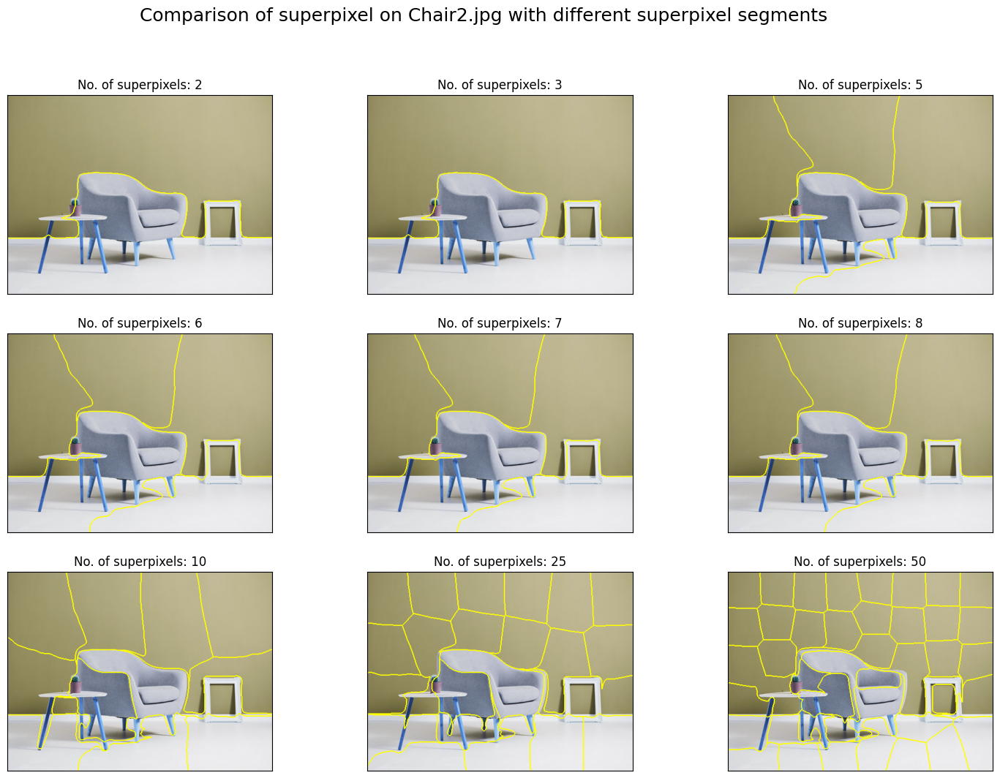

In [ ]:
# Apply the Superpixels algorithm to segment the image
sup_pix(img, img_name, [2, 3, 5, 6, 7, 8, 10, 25, 50])

From the above results we observe that as the number of superpixels increase, the image gets more segmented according to the pixel values, as expected. When the number of segments is 5, the image gets more or less correctly segmented marking boundaries around the different color regions of the furnitures in the picture (seperated by various shades). On increasing the number of superpixels the image starts to get over-segmented, thus gradually making the result less meaningful which is clearly observable for cases 25 and 50, where interpretation of segmentation is lost.

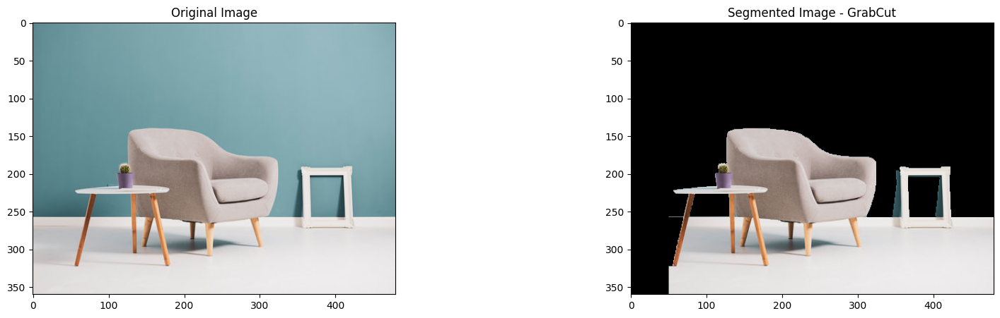

In [ ]:
# Apply the GrabCuts algorithm to segment the image
grabcut_segmentation(img)

The majority of the pixels belonging to the chair and wall have been correctly grouped together although there are some minor segmentation errors around the edges of the chair. For instance, some pixels belonging to the floor have been incorporated into the chair segmentation.

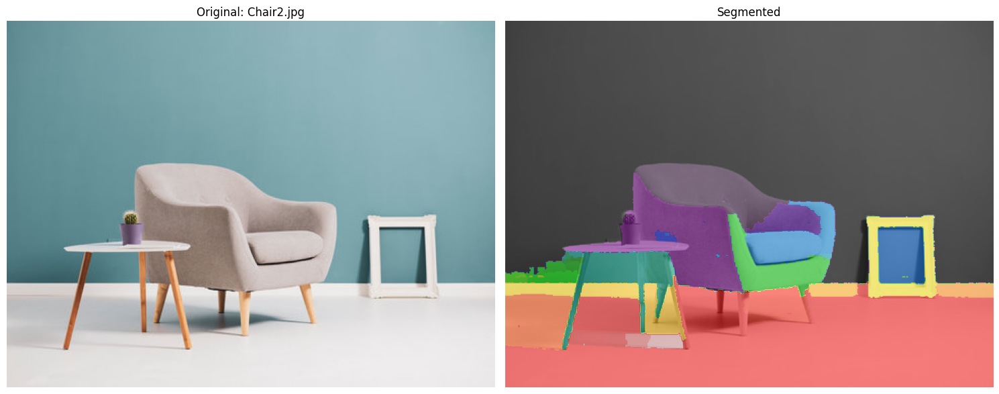

In [ ]:
# Apply the Watersheds algorithm to segment the image
water_shed(img_path, img_name)

Some pixels belonging to the background have been incorporated into the chair segmentation, especially noticeable on the left armrest.

In [ ]:
img_path = 'images/road/road1.jpg'
img_name = 'Road1.jpg'

img = cv2.imread(img_path)

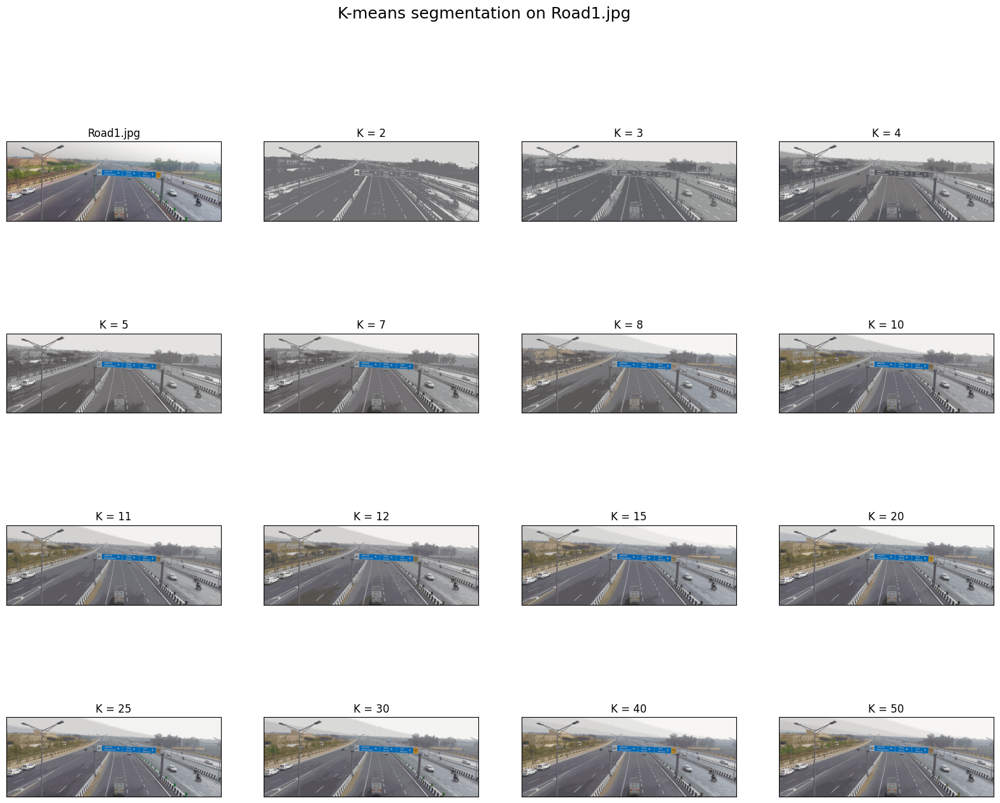

In [ ]:
img = cv2.imread(img_path)

# Apply the K-means clustering algorithm to segment the image
k_means(img, img_name)

From the above results, we observed that the segmentation improves with the increase in binning-size since the K-means algorithm can classify more classes (here, cluster of similar colors).

We also observe that the resulting image gets closer to the original image as we increase the number of bins. This is expected since increasing the bin-size leads to the pixel values of the original image getting classified into larger number of clusters resulting in almost similar distribution of the original image.

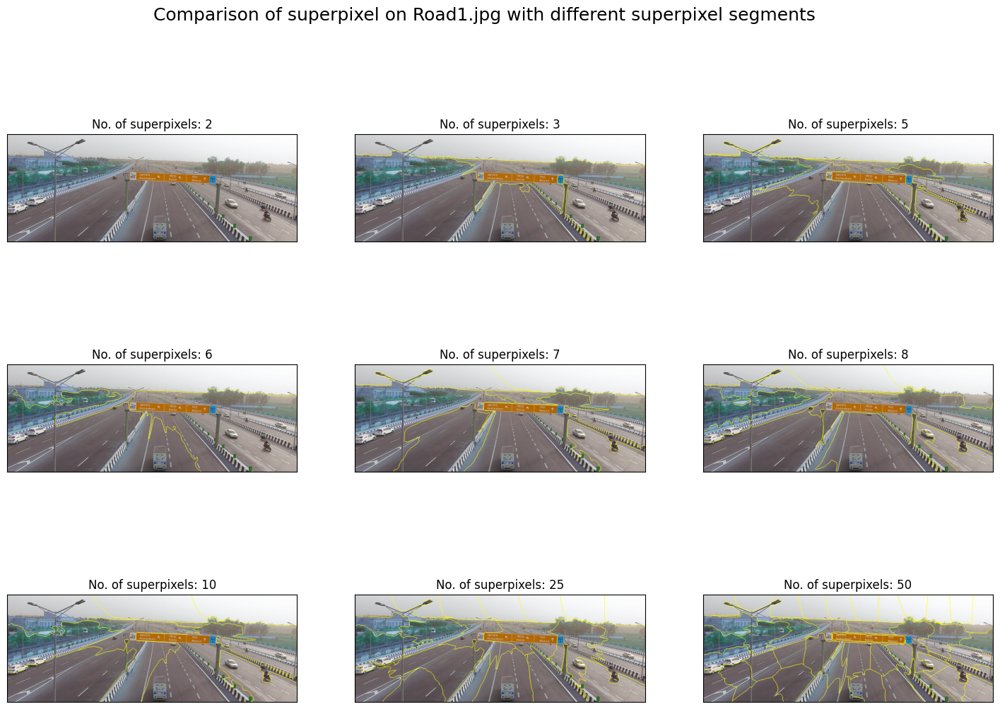

In [ ]:
# Apply the Superpixels algorithm to segment the image
sup_pix(img, img_name, [2, 3, 5, 6, 7, 8, 10, 25, 50])

From the above results we observe that as the number of superpixels increase, the image gets more segmented according to the pixel values, as expected. When the number of segments is 5, the image gets more or less correctly segmented marking boundaries around the different color regions of the road in the picture (seperated by various shades). On increasing the number of superpixels the image starts to get over-segmented, thus gradually making the result less meaningful which is clearly observable for cases 25 and 50, where interpretation of segmentation is lost.

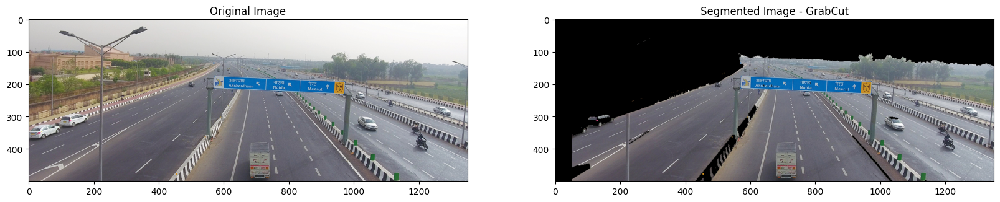

In [ ]:
# Apply the GrabCuts algorithm to segment the image
grabcut_segmentation(img)

This segmentation seems to have been partially effective in this case. It has successfully segmented the highway lanes, but there are significant errors in other parts of the image.

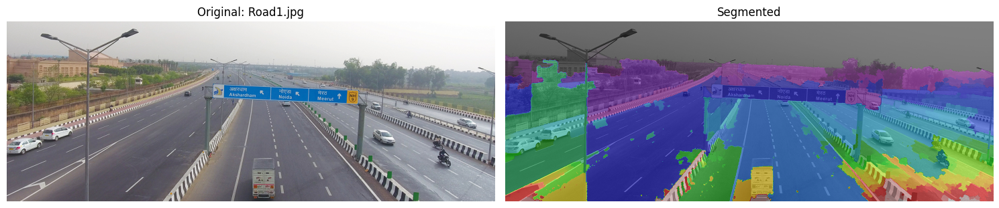

In [ ]:
# Apply the Watersheds algorithm to segment the image
water_shed(img_path, img_name)

The watershed method has over-segmented the grassy area on the left side of the image. Instead of one large segment, there are many small segments. It seems like this is a common weakness of the watershed method, especially in areas with low contrast or gradual intensity changes.

In [ ]:
img_path = 'images/road/road2.jpg'
img_name = 'Road2.jpg'

img = cv2.imread(img_path)

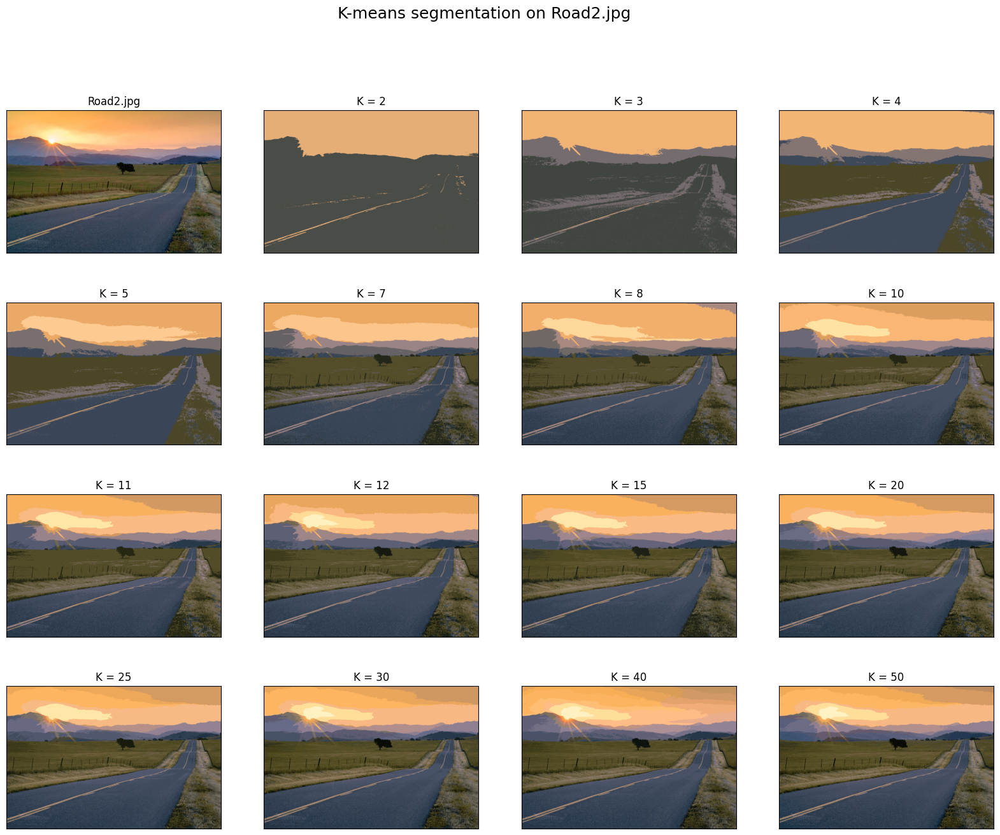

In [ ]:
# Apply the k-means algorithm to segment the image
k_means(img, img_name)

From the above results, we observed that the segmentation improves with the increase in binning-size since the K-means algorithm can classify more classes (here, cluster of similar colors).

We also observe that the resulting image gets closer to the original image as we increase the number of bins. This is expected since increasing the bin-size leads to the pixel values of the original image getting classified into larger number of clusters resulting in almost similar distribution of the original image.

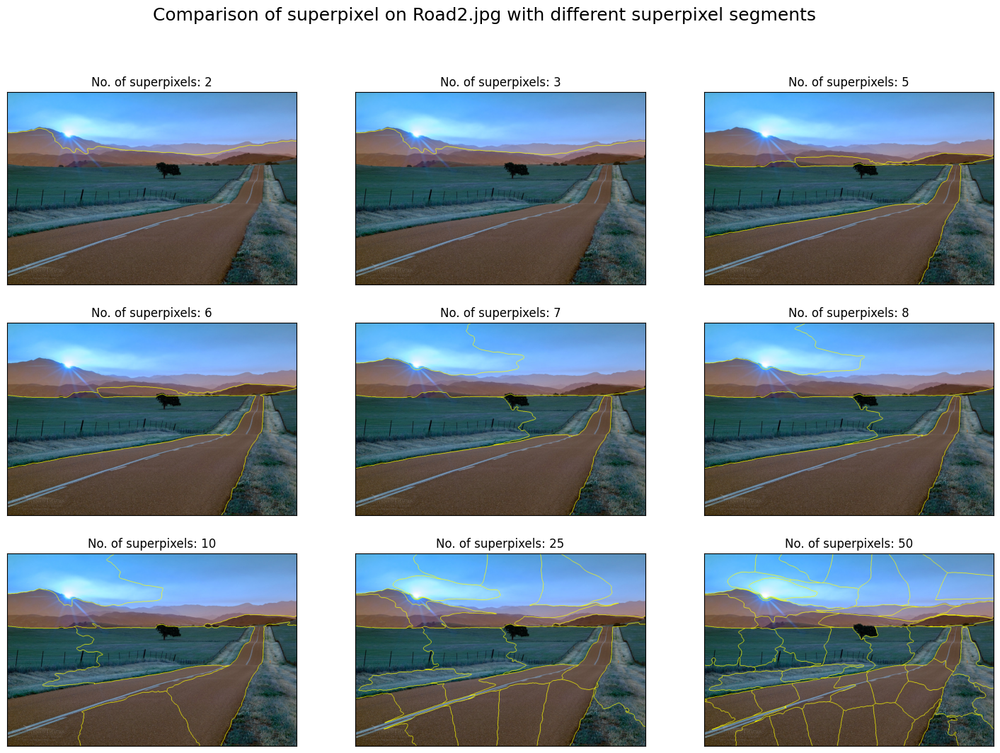

In [ ]:
# Apply the Superpixels algorithm to segment the image
sup_pix(img, img_name, [2, 3, 5, 6, 7, 8, 10, 25, 50])

From the above results we observe that as the number of superpixels increase, the image gets more segmented according to the pixel values, as expected. When the number of segments is 6, the image gets more or less correctly segmented marking boundaries around the different color regions of the road in the picture (seperated by various shades). On increasing the number of superpixels the image starts to get over-segmented, thus gradually making the result less meaningful which is clearly observable for cases 25 and 50, where interpretation of segmentation is lost.

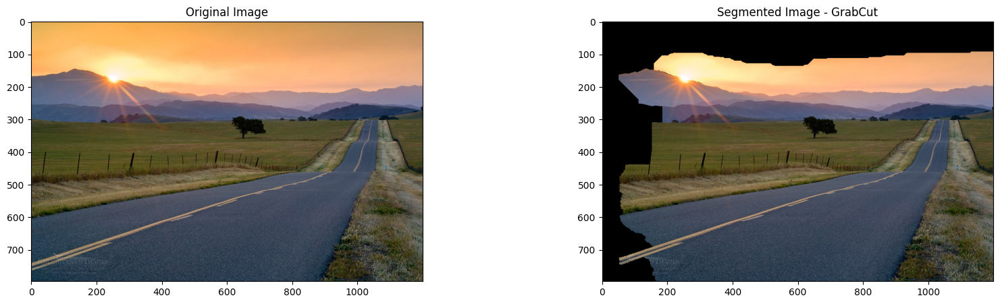

In [ ]:
# Apply the GrabCuts algorithm to segment the image
grabcut_segmentation(img)

The segmentation for this picture is clearly not good.

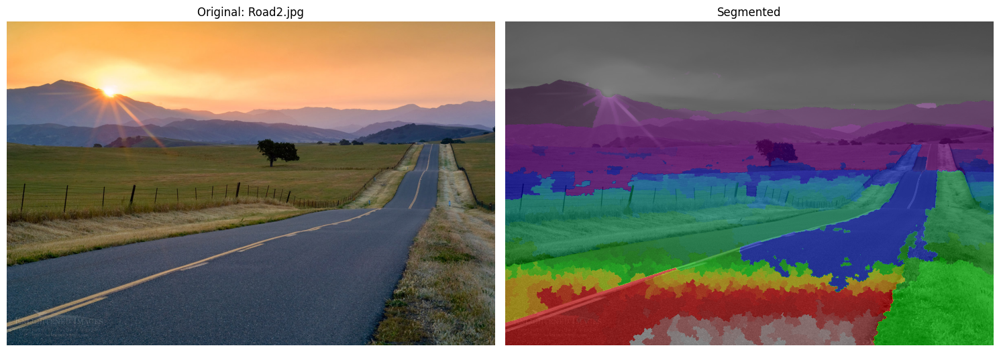

In [ ]:
# Apply the Watersheds algorithm to segment the image
water_shed(img_path, img_name)

The watershed segmentation has done a reasonable job of segmenting the road and the sky. However, it has also segmented some of the smaller objects in the image, such as the trees, into multiple regions.

In [ ]:
img_path = 'images/road/road3.jpg'
img_name = 'Road3.jpg'

img = cv2.imread(img_path)

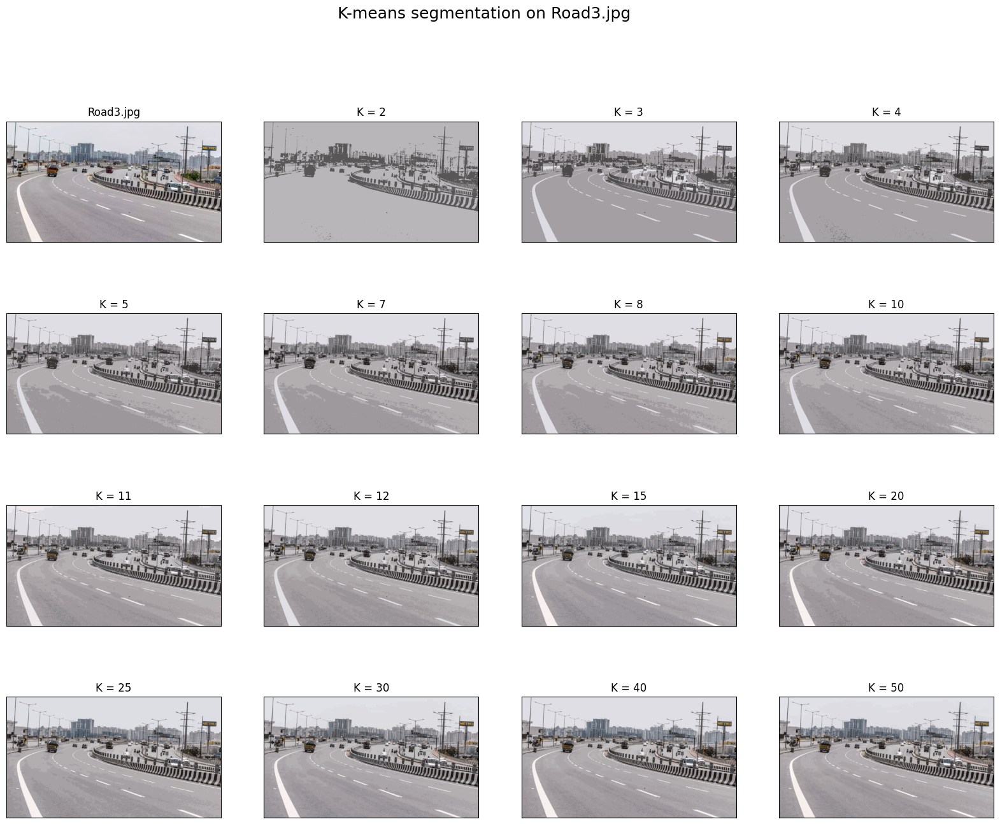

In [ ]:
img = cv2.imread(img_path)

# Apply the K-means clustering algorithm to segment the image
k_means(img, img_name)

From the above results, we observed that the segmentation improves with the increase in binning-size since the K-means algorithm can classify more classes (here, cluster of similar colors).

We also observe that the resulting image gets closer to the original image as we increase the number of bins. This is expected since increasing the bin-size leads to the pixel values of the original image getting classified into larger number of clusters resulting in almost similar distribution of the original image.

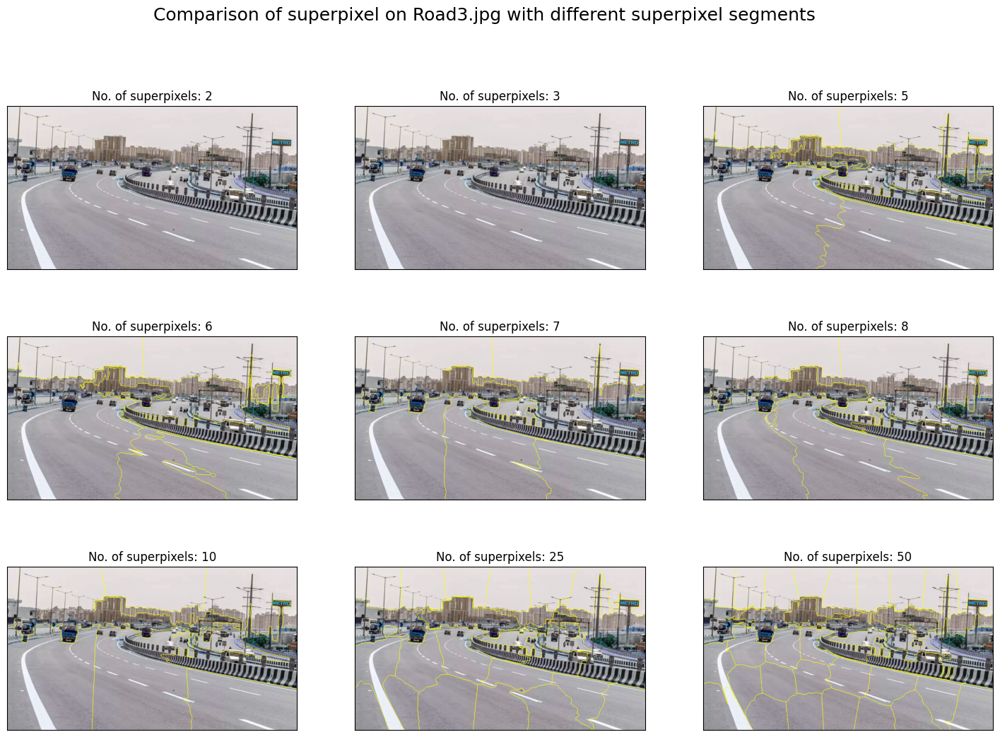

In [ ]:
# Apply the Superpixels algorithm to segment the image
sup_pix(img, img_name, [2, 3, 5, 6, 7, 8, 10, 25, 50])

From the above results we observe that as the number of superpixels increase, the image gets more segmented according to the pixel values, as expected. When the number of segments is 5, the image gets more or less correctly segmented marking boundaries around the different color regions of the road in the picture (seperated by various shades). On increasing the number of superpixels the image starts to get over-segmented, thus gradually making the result less meaningful which is clearly observable for cases 25 and 50, where interpretation of segmentation is lost.

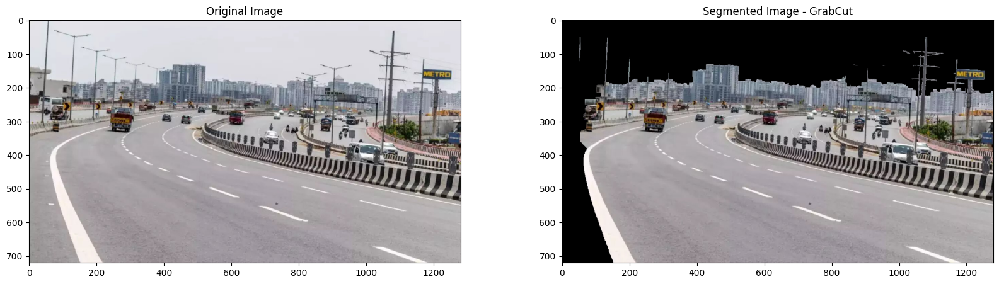

In [ ]:
# Apply the GrabCuts algorithm to segment the image
grabcut_segmentation(img)

Observation:

- **Foreground:** The GrabCut algorithm has successfully segmented the highway as the foreground. This is indicated by the consistent light-gray color assigned to the highway throughout the image.<br>

- **Background:** The buildings and the sky in the background have also been well-segmented. They are assigned a dark-gray color throughout. <br>

- **Sharp Edges:** The edges between the foreground and background are sharp, which means the GrabCut algorithm has made a clear distinction between the highway and its surroundings. <br>

- **Missed areas:** There are some minor areas that the GrabCut algorithm might have missed segmenting properly. For instance, the bottom left corner of the image shows a thin strip of the background color (dark-gray) intruding onto the highway (light-gray).

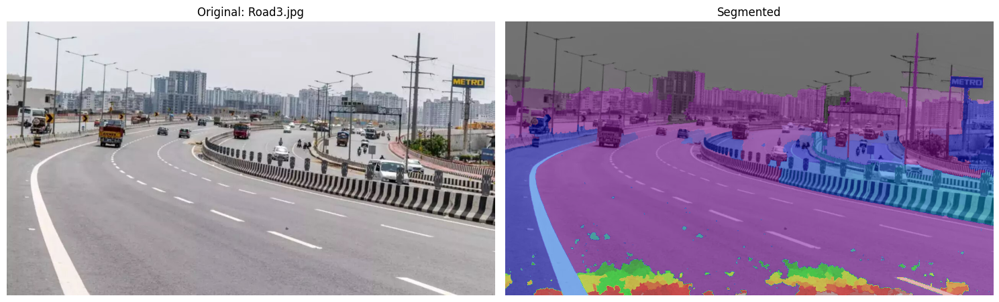

In [ ]:
# Apply the Watersheds algorithm to segment the image
water_shed(img_path, img_name)

The watershed segmentation has done a reasonable job of segmenting the major areas of the image, such as the highway lane, the sky, and the trees. However, it has also oversegmented some areas, such as the highway lane, which is now divided into several different regions.

In [ ]:
img_path = 'images/road/road4.jpg'
img_name = 'Road4.jpg'

img = cv2.imread(img_path)

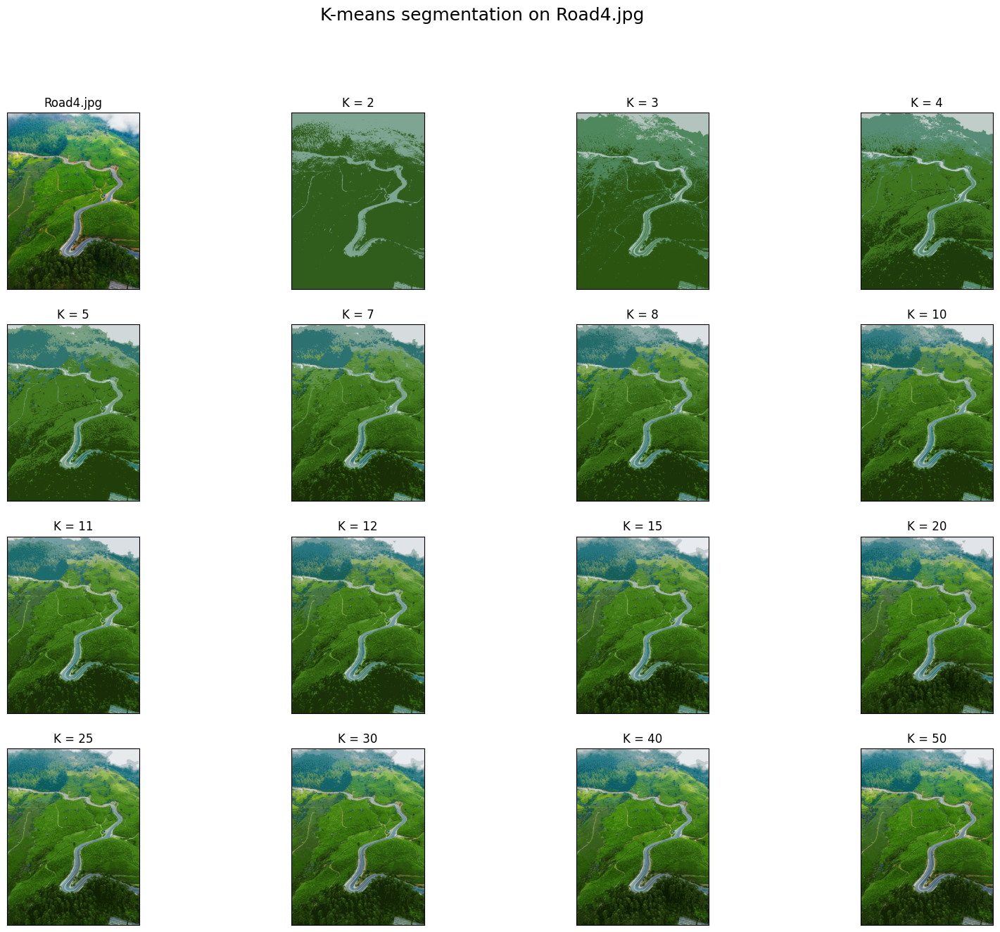

In [ ]:
# Apply the K-means clustering algorithm to segment the image
k_means(img, img_name)

From the above results, we observed that the segmentation improves with the increase in binning-size since the K-means algorithm can classify more classes (here, cluster of similar colors).

We also observe that the resulting image gets closer to the original image as we increase the number of bins. This is expected since increasing the bin-size leads to the pixel values of the original image getting classified into larger number of clusters resulting in almost similar distribution of the original image.

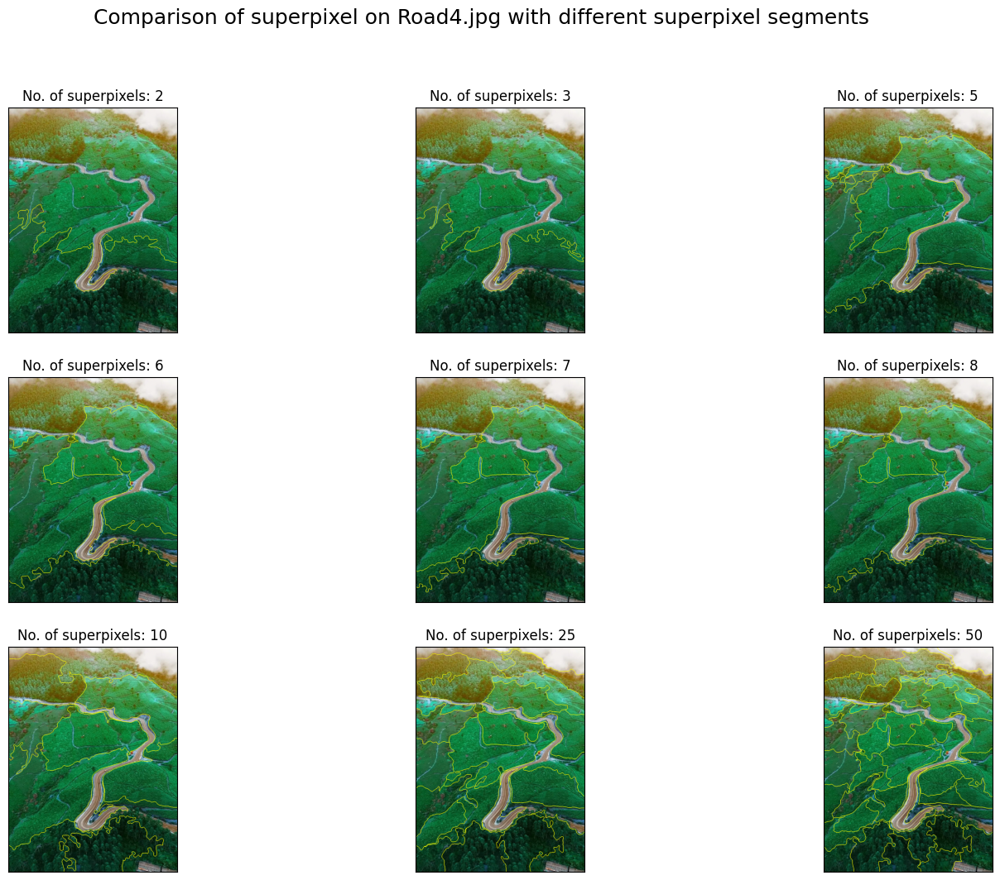

In [ ]:
# Apply the Superpixels algorithm to segment the image
sup_pix(img, img_name, [2, 3, 5, 6, 7, 8, 10, 25, 50])

From the above results we observe that as the number of superpixels increase, the image gets more segmented according to the pixel values, as expected. When the number of segments is 5, the image gets more or less correctly segmented marking boundaries around the different color regions of the valley in the picture (seperated by various shades). On increasing the number of superpixels the image starts to get over-segmented, thus gradually making the result less meaningful which is clearly observable for cases 25 and 50, where interpretation of segmentation is lost.

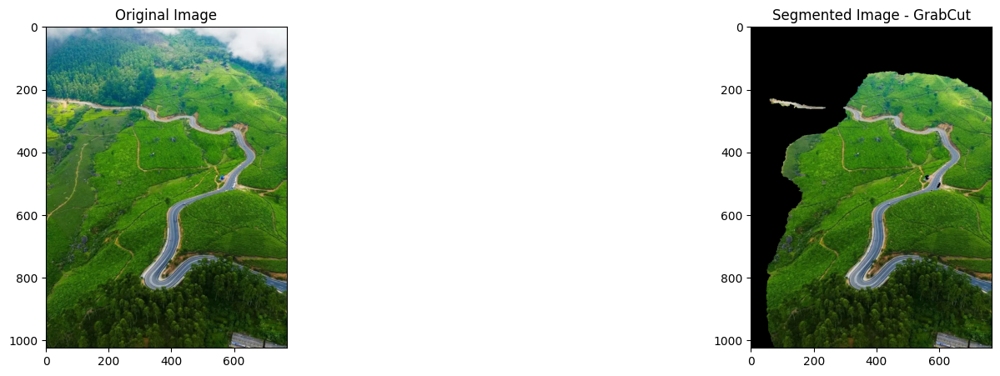

In [ ]:
# Apply the GrabCuts algorithm to segment the image
grabcut_segmentation(img)

The GrabCut method appears to have performed well in segmenting the main parts of the image into foreground and background regions. There are a few minor inaccuracies, but these can likely be improved if we can refine the user input specifying the foreground and background regions during the GrabCut process.

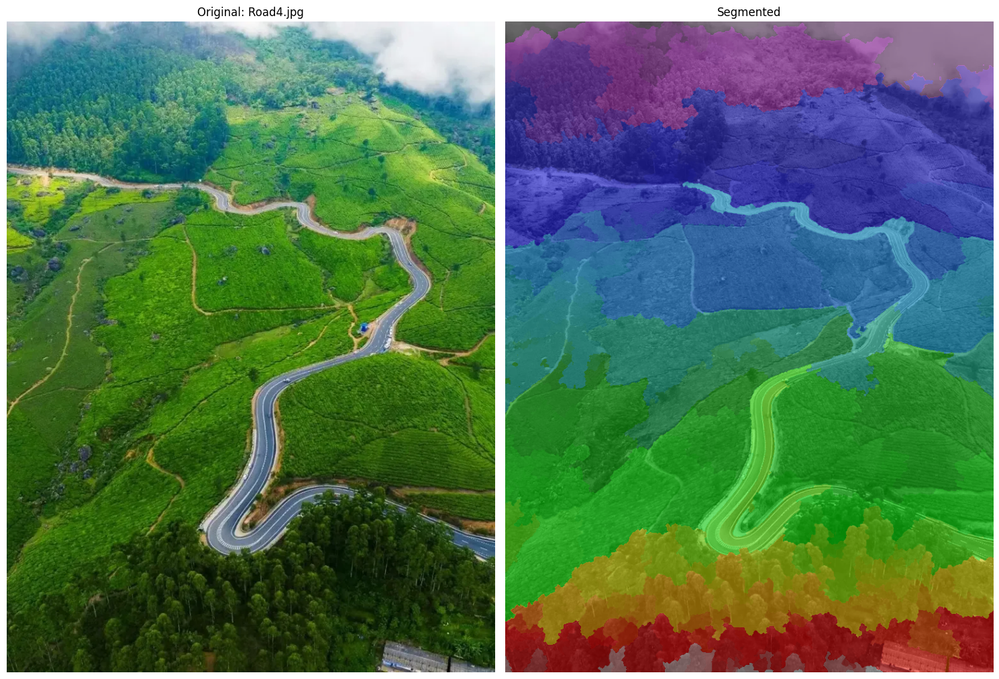

In [ ]:
# Apply the Watersheds algorithm to segment the image
water_shed(img_path, img_name)

While the watershed segmentation has identified the major objects in the image (road, sky, trees), it has resulted in a lot of unnecessary segmentation  within these objects.